# Syllabys:

1. [Image Processing](#image-processing)
2. [TorchVision (Image Classification with PyTorch)](#torchvision-image-classification-using-pytorch)
3. [Object Detection](#object-detection)
4. [Image Segmentation](#image-segmentation)
5. [Visual embeddings and image retrival](#visual-embeddings-and-image-retrieval)
6. [Re-Identification and Object Tracking](#re-identification-and-object-tracking)
7. [Optical Character Recognition (OCR)](#optical-character-recognition-ocr)
8. [Keypoint Detection](#keypoint-detection)
9. [Computer Vision Libraries](#computer-vision-libraries)

<br/>

Tasks `not covered` in syllabys but are part of CV domain:

- image captioning
- image Q&A
- image generation (unconditional and text-to-image)
- 3D modeling and meshes
- depth estimation
- video classification
- rotated (or oriented) object detection
- image-to-image synthesis

# Image Processing

In [ ]:
!pip install opencv-python

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt


%matplotlib inline

plt.rcParams['figure.figsize'] = (20, 8)

In [2]:
camel_img = cv2.imread("./supplementary_data/camels1.jpg")
type(camel_img), camel_img.shape

(numpy.ndarray, (3000, 4501, 3))

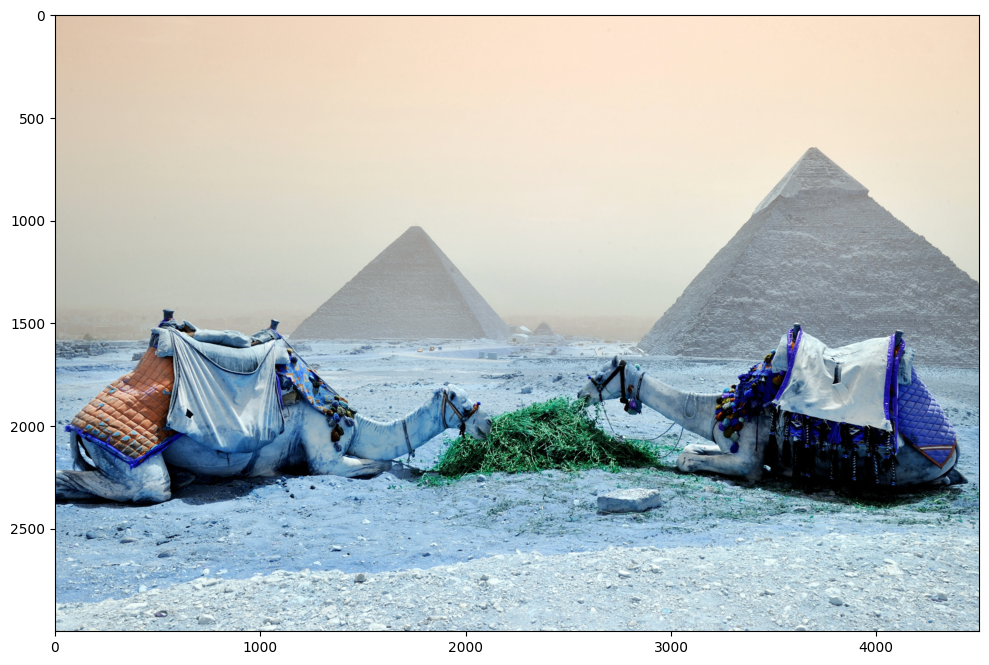

In [3]:
plt.imshow(camel_img)

By default, OpenCV reads image in BGR style.

BGR is another order for RGB channel format.

<h3>BGR channels:</h3>

![Image channels](https://upload.wikimedia.org/wikipedia/commons/5/56/RGB_channels_separation.png)

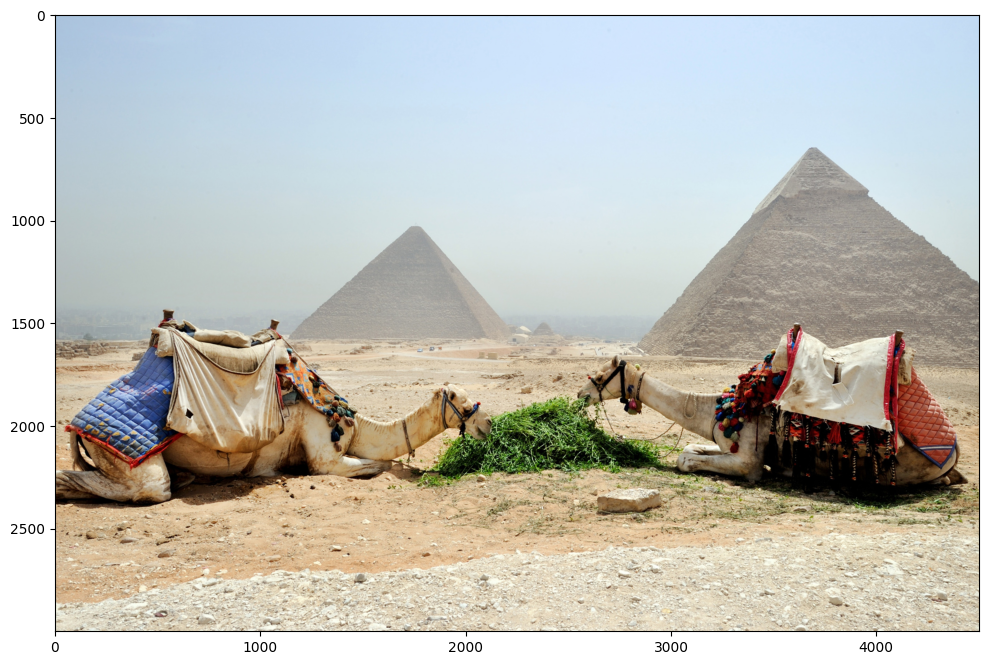

In [4]:
camel_rgb = cv2.cvtColor(camel_img, cv2.COLOR_BGR2RGB)
plt.imshow(camel_rgb)

Another method to represent image is HSV format - Hue, Saturation, Value.

For HSV, hue range is [0,179], saturation range is [0,255], and value range is [0,255].

![Image representation](https://miro.medium.com/v2/resize:fit:1400/1*W30TLUP9avQwyyLfwu7WYA.jpeg)


HSV format is usually used when work with colors is needed, such as color segmentation or color shift.

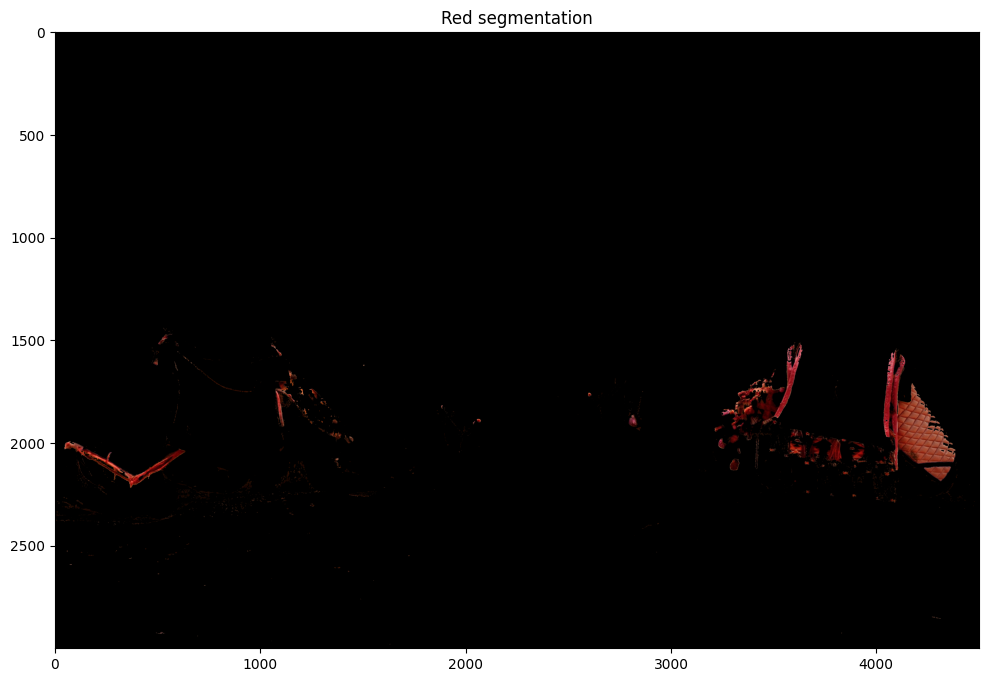

In [5]:
hsv_image = cv2.cvtColor(camel_img, cv2.COLOR_BGR2HSV)

# 0-10 and 165-180 are values of the red color in HSV schema
mask = cv2.inRange(hsv_image, (0, 100, 20), (10, 255, 255)) | cv2.inRange(hsv_image, (165, 100, 20), (180, 255, 255))

output = cv2.bitwise_and(camel_rgb, camel_rgb, mask = mask)
plt.imshow(output)
plt.title('Red segmentation')
plt.show()

(3000, 4501, 3)
(1000, 1500, 3)


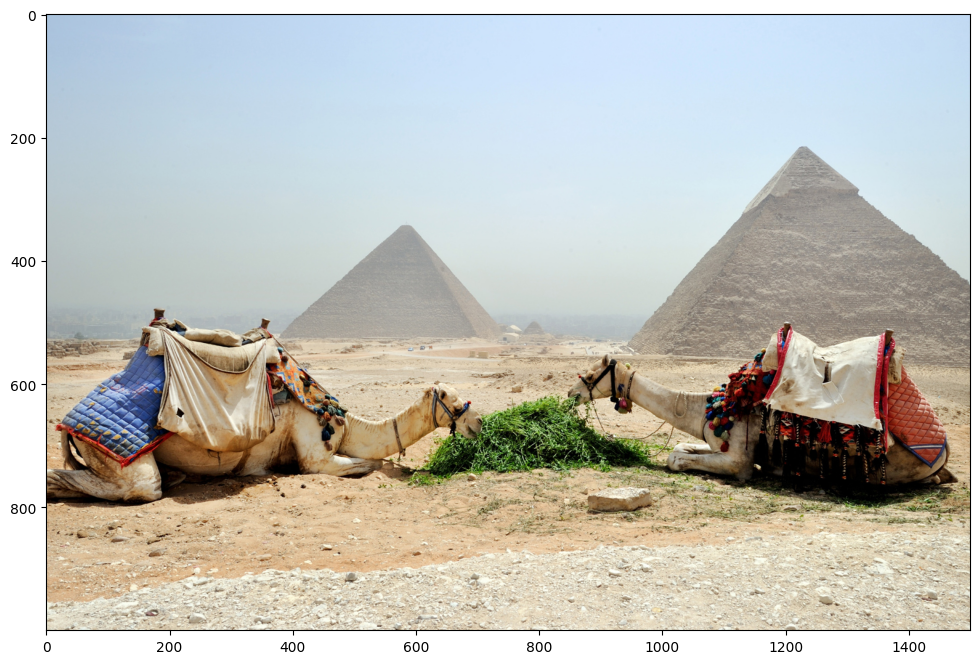

In [6]:
print(camel_rgb.shape)

# Note: that shape returns values in [HEIGHT, WIDTH, CHANELLS] order (or [Y, X, Z]), while resize method needs [X, Y] order

camel_rgb_resized = cv2.resize(camel_rgb, (1500, 1000))
print(camel_rgb_resized.shape)
plt.imshow(camel_rgb_resized)

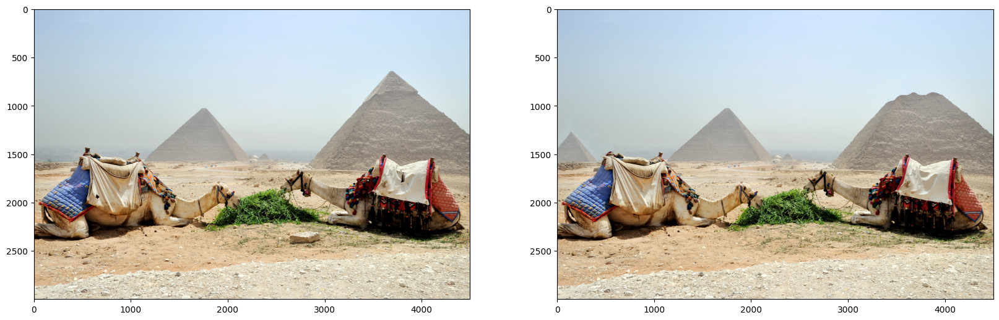

In [7]:
camel_img_2 = cv2.imread('./supplementary_data/camels2.jpg')
camel_rgb_2 = cv2.cvtColor(camel_img_2, cv2.COLOR_BGR2RGB)

fig, axs = plt.subplots(1, 2)
axs[0].imshow(camel_rgb)
axs[1].imshow(camel_rgb_2)

plt.show()

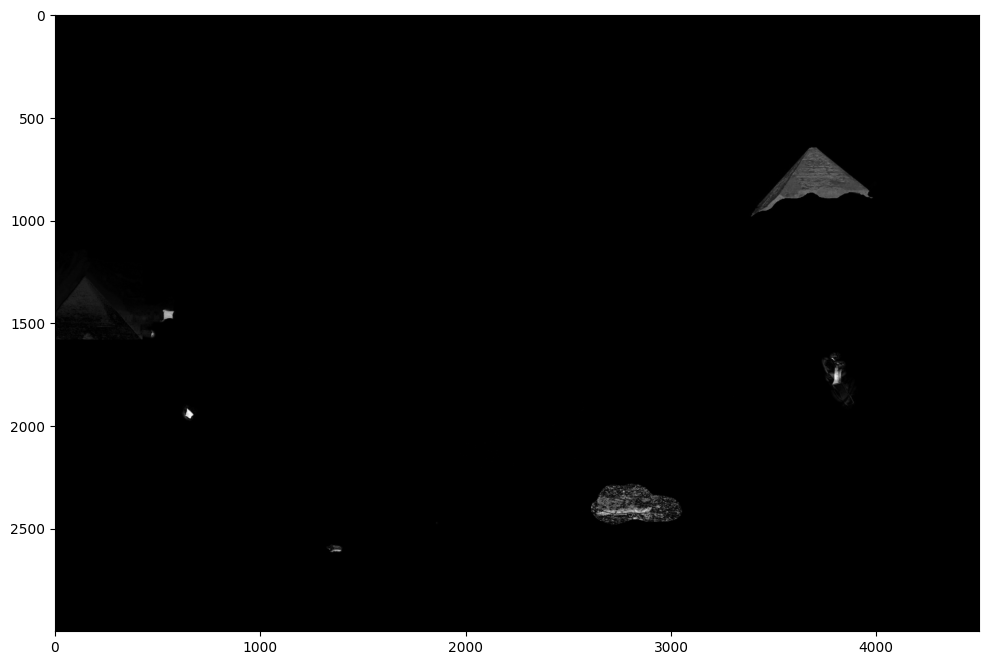

In [8]:
camel_gray = cv2.cvtColor(camel_img, cv2.COLOR_BGR2GRAY)
camel_gray_2 = cv2.cvtColor(camel_img_2, cv2.COLOR_BGR2GRAY)

diff = cv2.absdiff(camel_gray, camel_gray_2)
plt.imshow(diff, cmap='gray')

Difference between image shows the pixel change between two images. For further use, it's more crucial to have the output as information whether this pixel was changed or not (as binary value). And have a possibility to determine what kind of change should be counted as significant.

For such case `thresholding` technique is used:

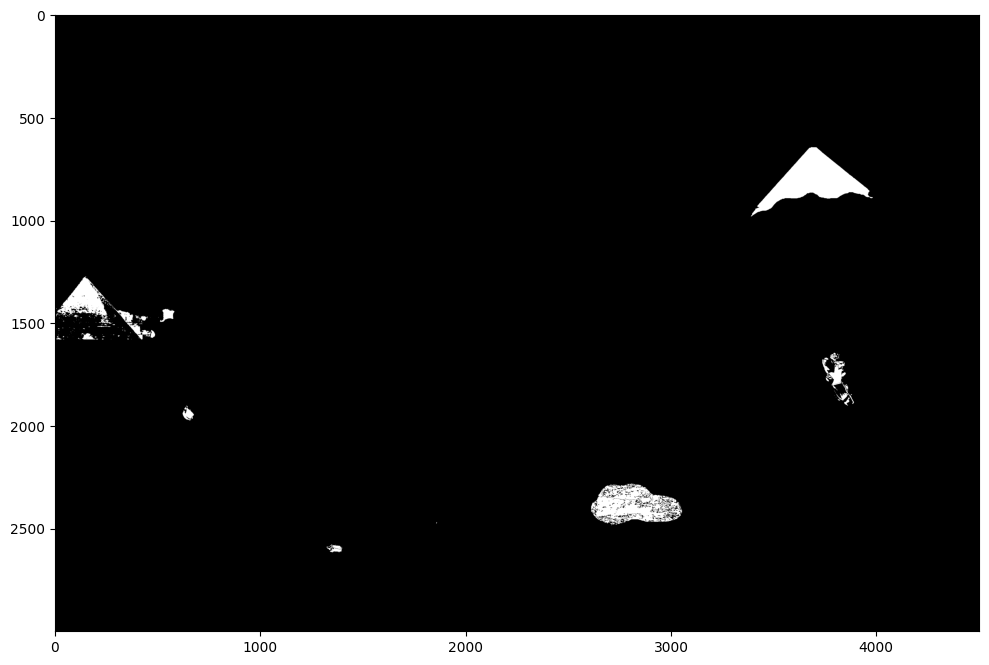

In [ ]:
thresh = cv2.threshold(diff, 15, 255, cv2.THRESH_BINARY)[1]
plt.imshow(thresh, cmap='gray')

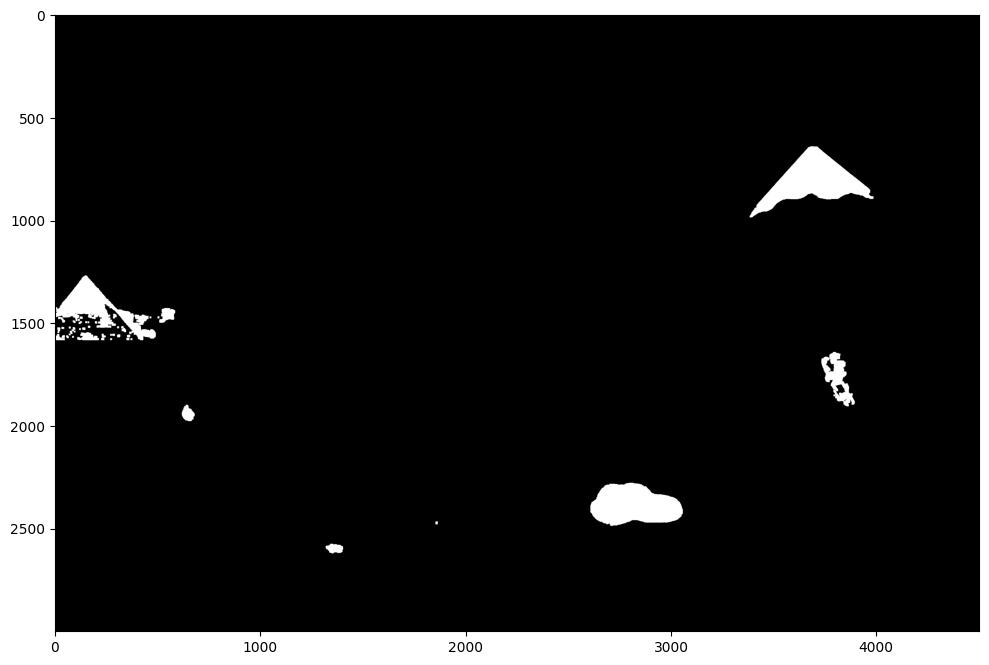

In [ ]:
kernel = np.ones((5,5), np.uint8)
dilate = cv2.dilate(thresh, kernel, iterations=2)
plt.imshow(dilate, cmap='gray')

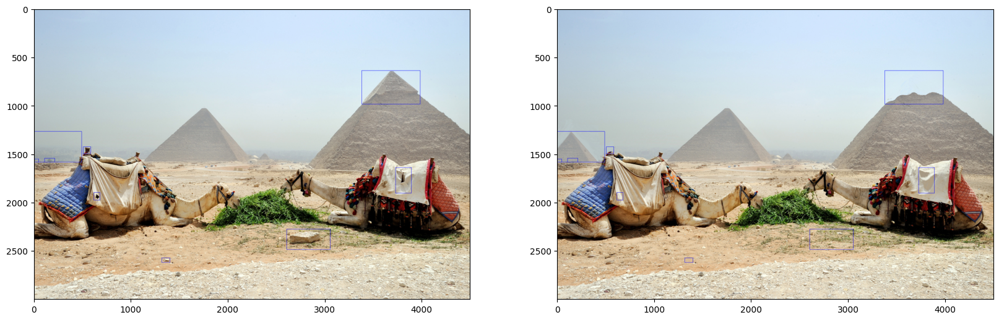

In [ ]:
contours, _ = cv2.findContours(dilate.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
for contour in contours:
    if cv2.contourArea(contour) > 500:
        # Calculate bounding box around contour
        x, y, w, h = cv2.boundingRect(contour)
        # Draw rectangle - bounding box on both images
        cv2.rectangle(camel_rgb, (x, y), (x+w, y+h), (0,0,255), 2)
        cv2.rectangle(camel_rgb_2, (x, y), (x+w, y+h), (0,0,255), 2)

fig, axs = plt.subplots(1, 2)
axs[0].imshow(camel_rgb)
axs[1].imshow(camel_rgb_2)

plt.show()

<h3>Adaptive thresholding</h3>

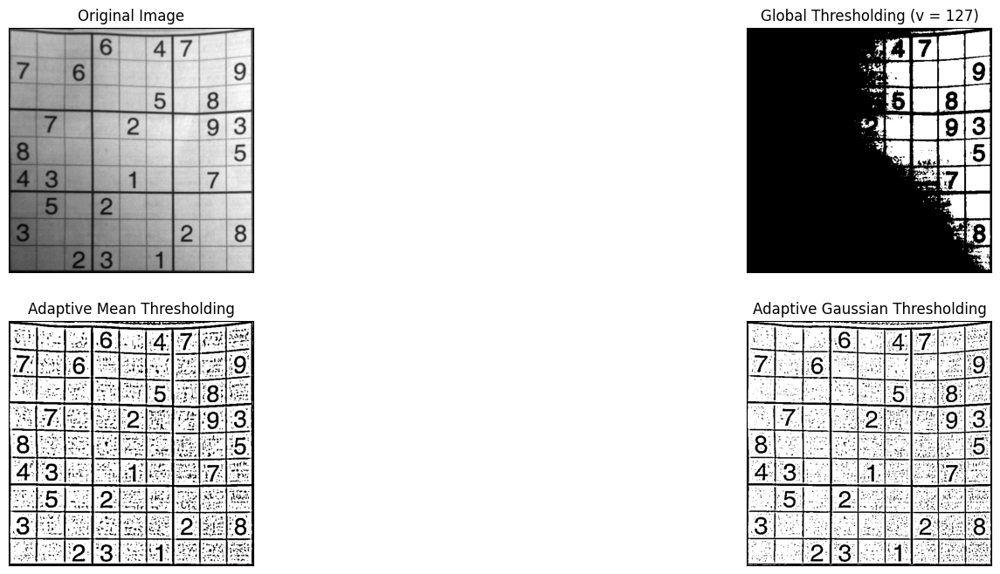

In [ ]:
img = cv2.imread('./supplementary_data/sudoku.png', cv2.IMREAD_GRAYSCALE)

ret, th1 = cv2.threshold(img, 127, 255, cv2.THRESH_BINARY)
th2 = cv2.adaptiveThreshold(img, 255, cv2.ADAPTIVE_THRESH_MEAN_C,
                            cv2.THRESH_BINARY, 11, 2)
th3 = cv2.adaptiveThreshold(img, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                            cv2.THRESH_BINARY, 11, 2)
titles = ['Original Image', 'Global Thresholding (v = 127)',
          'Adaptive Mean Thresholding', 'Adaptive Gaussian Thresholding']
images = [img, th1, th2, th3]

for i in range(4):
    plt.subplot(2, 2, i+1), plt.imshow(images[i], 'gray')
    plt.title(titles[i])
    plt.xticks([]), plt.yticks([])
plt.show()

<h3>Blurring</h3>

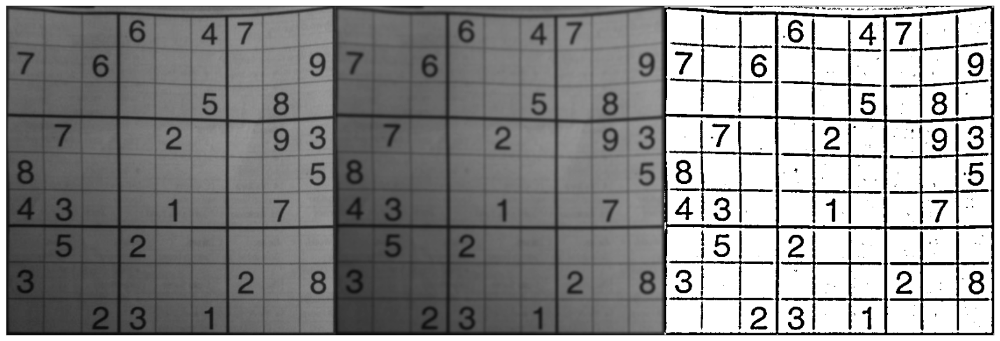

In [ ]:
img = cv2.imread('./supplementary_data/sudoku.png', cv2.IMREAD_GRAYSCALE)
blurred_img = cv2.blur(img, (5, 5))
blurred_thresh = cv2.adaptiveThreshold(blurred_img, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                       cv2.THRESH_BINARY, 11, 2)

plt.imshow(cv2.hconcat([img, blurred_img, blurred_thresh]), cmap='gray')
plt.xticks([]), plt.yticks([]);

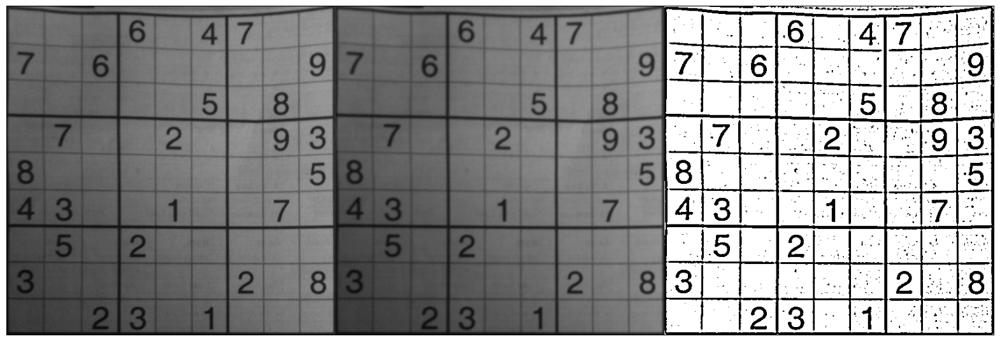

In [ ]:
img = cv2.imread('./supplementary_data/sudoku.png', cv2.IMREAD_GRAYSCALE)
blurred_img = cv2.GaussianBlur(img, (5, 5), 0)
blurred_thresh = cv2.adaptiveThreshold(blurred_img, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                       cv2.THRESH_BINARY, 11, 2)

plt.imshow(cv2.hconcat([img, blurred_img, blurred_thresh]), cmap='gray')
plt.xticks([]), plt.yticks([]);

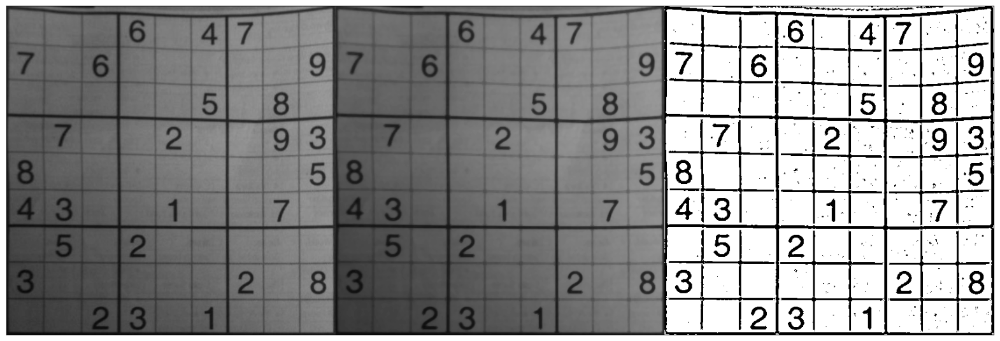

In [ ]:
img = cv2.imread('./supplementary_data/sudoku.png', cv2.IMREAD_GRAYSCALE)
blurred_img = cv2.medianBlur(img, 5)
blurred_thresh = cv2.adaptiveThreshold(blurred_img, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                       cv2.THRESH_BINARY, 11, 2)

plt.imshow(cv2.hconcat([img, blurred_img, blurred_thresh]), cmap='gray')
plt.xticks([]), plt.yticks([]);

<h3>Edge and Line Detection</h3>

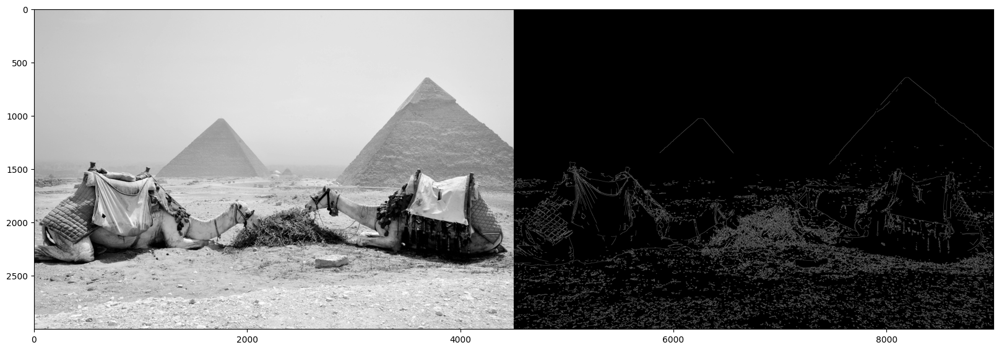

In [4]:
camel_gray = cv2.imread("./supplementary_data/camels1.jpg", cv2.IMREAD_GRAYSCALE)
edges = cv2.Canny(camel_gray, 100, 200, apertureSize=3)

plt.imshow(cv2.hconcat([camel_gray, edges]), cmap='gray')

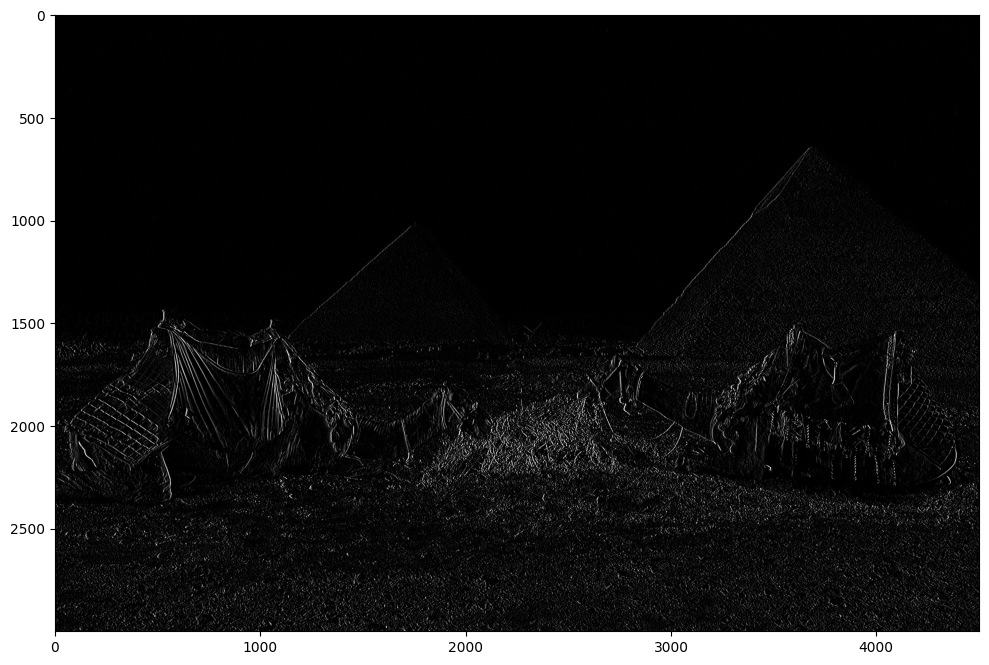

In [ ]:
# Sobel filter
kernel = np.array([[1, 0, -1],
                   [2, 0, -2],
                   [1, 0, -1]])

edges = cv2.filter2D(src=camel_gray, ddepth=-1, kernel=kernel)
plt.imshow(edges, cmap='gray')

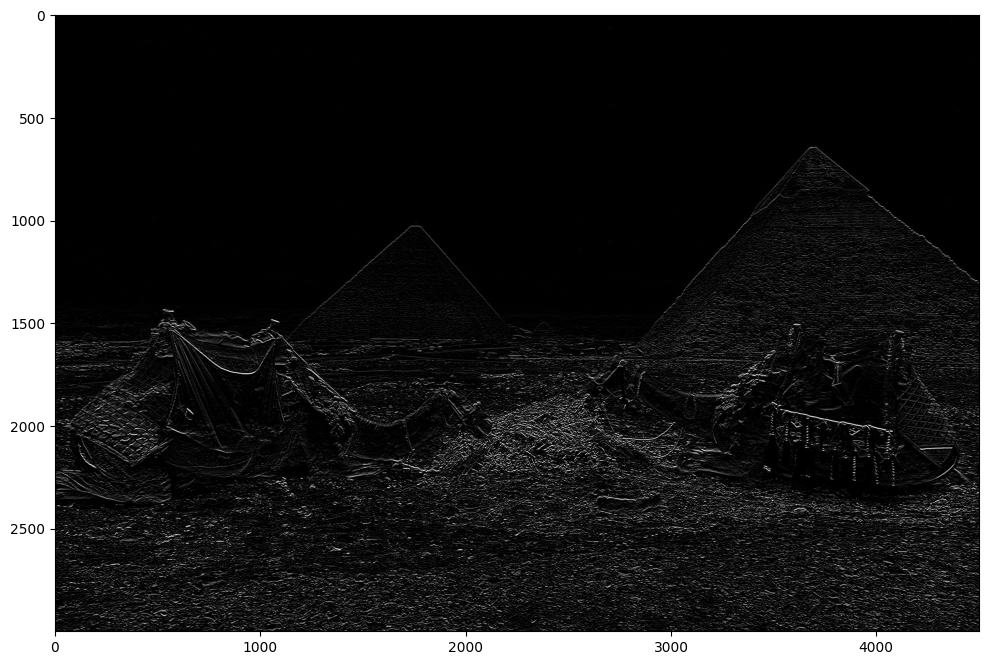

In [ ]:
kernel = np.array([[1, 0, -1],
                   [2, 0, -2],
                   [1, 0, -1]])

edges = cv2.filter2D(src=camel_gray, ddepth=-1, kernel=kernel.T)
plt.imshow(edges, cmap='gray')

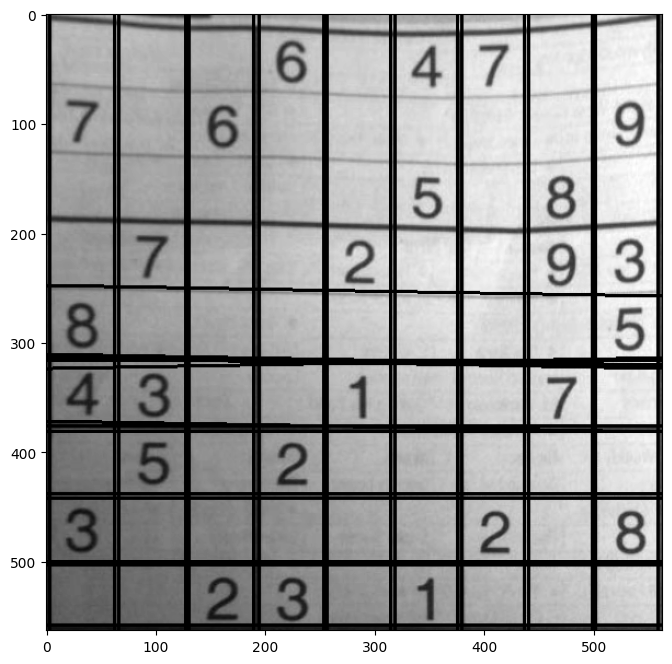

In [41]:
img = cv2.imread('./supplementary_data/sudoku.png', cv2.IMREAD_GRAYSCALE)
blurred_img = cv2.medianBlur(img, 5)
blurred_thresh = cv2.adaptiveThreshold(blurred_img, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                       cv2.THRESH_BINARY, 11, 2)


edges = cv2.Canny(blurred_thresh, 100, 200, apertureSize=3)
lines = cv2.HoughLines(edges, 1, np.pi/180, 200)

for line in lines:
    rho, theta = line[0]
    a = np.cos(theta)
    b = np.sin(theta)
    x0 = a*rho
    y0 = b*rho
    x1 = int(x0 + 1000*(-b))
    y1 = int(y0 + 1000*(a))
    x2 = int(x0 - 1000*(-b))
    y2 = int(y0 - 1000*(a))
    cv2.line(img, (x1, y1), (x2, y2), (0, 0, 255), 2)

plt.imshow(img, cmap='gray')

# TorchVision (Image Classification using PyTorch)

`torchvision` is an additional PyTorch library that contains models and utils to work with visual tasks.

It contains:

- `transforms` module that performs transformations for image and annotation;
- `models` module that contains a list of vision models with pre-trained weights;
- `datasets` module that contains many built-in datasets and utility classes for building your own datasets;
- `io` and `utils` modules that provide various functions and operations (such as image reading/saving, encoding/decoding, 
video reading, etc).


There's a module called [references](https://github.com/pytorch/vision/tree/main/references) in `torchvision` repository where training scripts and examples are presented.

In [15]:
!git clone https://github.com/pytorch/vision.git && mv vision/references references && rm -rf vision

Cloning into 'vision'...
remote: Enumerating objects: 443980, done.
remote: Counting objects: 100% (24442/24442), done.
remote: Compressing objects: 100% (1187/1187), done.
remote: Total 443980 (delta 23260), reused 24354 (delta 23217), pack-reused 419538
Receiving objects: 100% (443980/443980), 877.13 MiB | 16.50 MiB/s, done.
Resolving deltas: 100% (412340/412340), done.


TorchVision contains most popular CV architectures and models:

- ResNet
- MobileNet
- VGG
- Inception
- EfficientNet
- Vision Transformers (Transformer-based architecture unlike other CNN listed - ViT, SwinTransformers)
- and etc.

A full list is available [at the link](https://pytorch.org/vision/stable/models.html).

[PapersWithCode](https://paperswithcode.com/task/image-classification) contains a list of tasks, datasets and models benchmarks. It could be used to find what models are State-of-the-Art and on which tasks.

In [2]:
!torchrun ./references/clasification/train.py --model resnet101 --epochs 100 -b 16 \
 --data-path {your_dataset_path} \
 --output-dir resnet101_100

usage: torchrun [-h] [--nnodes NNODES] [--nproc-per-node NPROC_PER_NODE]
                [--rdzv-backend RDZV_BACKEND] [--rdzv-endpoint RDZV_ENDPOINT]
                [--rdzv-id RDZV_ID] [--rdzv-conf RDZV_CONF] [--standalone]
                [--max-restarts MAX_RESTARTS]
                [--monitor-interval MONITOR_INTERVAL]
                [--start-method {spawn,fork,forkserver}] [--role ROLE] [-m]
                [--no-python] [--run-path] [--log-dir LOG_DIR] [-r REDIRECTS]
                [-t TEE] [--node-rank NODE_RANK] [--master-addr MASTER_ADDR]
                [--master-port MASTER_PORT] [--local-addr LOCAL_ADDR]
                training_script ...
torchrun: error: the following arguments are required: training_script, training_script_args


In [ ]:
# model inference

from torchvision.models import get_model, get_weight
from torchvision.io import read_image
import torchvision.transforms as transforms
import torch

DATASET_PATH = 'your_dataset_path'
CLASSES_AMOUNT = 5

state = torch.load(f"{DATASET_PATH}/checkpoint.pth")
resnet101 = get_model('resnet101')
resnet101.classifier[1] = torch.nn.Linear(1280, CLASSES_AMOUNT)
resnet101.load_state_dict(state['model'])
resnet101.eval()

In [ ]:
weights = get_weight("ResNet101_Weights.IMAGENET1K_V1")
preprocess = weights.transforms()
weights

In [ ]:
image = read_image("EXAMPLE.png")
batch = preprocess(image).unsqueeze(0)

prediction = resnet101(batch).squeeze(0).softmax(0)
class_id = prediction.argmax().item()
score = prediction[class_id].item()
prediction = prediction.tolist()

Most common evaluation metrics of Image Classification models are:

- top-n accuracy (usually, top-1 or just accuracy)
- precision/recall and its curve
- f1-score


# Object Detection

The goal of Object Detection is to recognize and locate objects of interest (in any amount) in an image or video.

Example:

![Computer vision tasks](https://www.researchgate.net/profile/Dae-Young-Kang/publication/346091812/figure/fig5/AS:979480482955270@1610537753983/Computer-vision-tasks-Adapted-from.png)


The main challenge is to choose the correct bounding box.

## Sliding window

One of the oldest approach is to use pre-defined window, slide it over the image and classify the result using CNN architecture.

Example:

![Sliding window](https://www.hackerearth.com/blog/wp-content/uploads/2018/08/Fig-3.gif)


Such technique is very slow (needs to slide the window through whole image) and unreliable (window has to be predifined).


## Object detection techniques

Modern Object Detection models usually generate a lot of bounding boxes over areas of possible interest and perform classification.


<h3>Intersection over Union</h3>


To optimize generation of bounding boxes by model the metric IoU (intersection over Union) is used.

![IoU schema](https://dkharazi.github.io/b7562d4f519aec9a5eafdd40c65f7fd6/iou.jpg)

Formula:

$ IoU = {Area  of  Overlap \over Area  of  Union} $

Regarding IoU:

- Measures the similarity of two bounding boxes
- Trains a bounding box against the coordinates of the true bounding box that are supplied manually (supervision)
- An iou threshold of 0.5 is considered as correct prediction

In [ ]:
def box_iou(boxes1, boxes2):
    """Compute pairwise IoU across two lists of anchor or bounding boxes."""
    box_area = lambda boxes: ((boxes[:, 2] - boxes[:, 0]) *
                              (boxes[:, 3] - boxes[:, 1]))
    # Shape of `boxes1`, `boxes2`, `areas1`, `areas2`: (no. of boxes1, 4),
    # (no. of boxes2, 4), (no. of boxes1,), (no. of boxes2,)
    areas1 = box_area(boxes1)
    areas2 = box_area(boxes2)
    # Shape of `inter_upperlefts`, `inter_lowerrights`, `inters`: (no. of
    # boxes1, no. of boxes2, 2)
    inter_upperlefts = torch.max(boxes1[:, None, :2], boxes2[:, :2])
    inter_lowerrights = torch.min(boxes1[:, None, 2:], boxes2[:, 2:])
    inters = (inter_lowerrights - inter_upperlefts).clamp(min=0)
    # Shape of `inter_areas` and `union_areas`: (no. of boxes1, no. of boxes2)
    inter_areas = inters[:, :, 0] * inters[:, :, 1]
    union_areas = areas1[:, None] + areas2 - inter_areas
    return inter_areas / union_areas

<h3>Non-Maximum Suppression</h3>

When a large amount of boxes is generated, it's crucial to perform filtering with a technique called Non-Maximum Suppression.
These bounding boxes may overlap or be located at different positions, but they all represent the same object. 
NMS is used to identify and remove redundant or incorrect bounding boxes and to output a single bounding box for each object in the image.


NMS steps:

1. Models that predicts bounding box for an object also give a probability of an object located in this box (called $p_c$).
2. Filter out $p_c < 0.6$
3. Filter overlapping boxes (that have IoU > 0.5) and save only those with the highest $p_c$.


<h3>Anchors</h3>

Anchor boxes, also known as anchor boxes or priors, play a crucial role in object detection algorithms. The primary purpose of anchor boxes is to handle variations in object scale, aspect ratio, and position within an image.

Some windows should be incredibly small, and others should be bigger. Similarly, some boxes should be vertical, like those of pedestrians, and others should be horizontal, like buses.

This is where the concept of anchor boxes comes into play, using an anchor box, we're going to predefine a set of plausible boxes for the classes we want to detect, and then predict them.

Example of such pattern:

![Anchor box examples](https://www.thinkautonomous.ai/blog/content/images/size/w1000/2023/05/e21dbae8-23d3-4c49-96f0-681ea8d8ae9f.png)


So box regression becomes more simple problem - choose most suitable anchor box and predict its offset:

![Anchor box offset prediction](https://images.surferseo.art/5b3c3bab-0280-4ad0-b18a-43da71eea2e2.png)

## Region-based CNN (R-CNN)

More advanced method of object detection than sliding windows proposed initially. It has changed during three versions:

- R-CNN
- Fast R-CNN
- Faster R-CNN

The main goal is in quickly and correctly generating the Regions of Interest (RoI). 

![Faster R-CNN architecture](https://i0.wp.com/towardsmachinelearning.org/wp-content/uploads/2021/07/RCNN-thumbanil.png?fit=1892%2C902&ssl=1)


Steps:

1. Feature maps transformation using Conv Layers.
2. Separate part of the network called Region Proposal Network (RPN) generates region proposals (RoIs) using anchors.
3. RoIs are mapped with Feature Maps (RoI pulling) and transformed into feature vectors.
4. Feature vectors are forwarded into Classifier module that classifies the object.

In [ ]:
# R-CNN network could be trained using TorchVision
# and inferenced in the same way as Classification Models from previous blocks

# All relevant tools are located in references/detection folder

# Example on COCO dataset:
!torchrun references/detection/train.py --dataset coco --model fasterrcnn_resnet50_fpn --epochs 26\
    --lr-steps 16 22 --aspect-ratio-group-factor 3 --weights-backbone ResNet50_Weights.IMAGENET1K_V1

## You Only Look Once (YOLO)

One of the most popular CNN architectures for object detection nowadays is YOLO. 
Comparing to R-CNN architecture that analyzes the image several times, YOLO performs single forward pass.

![YOLO architecture](https://miro.medium.com/v2/resize:fit:720/format:webp/1*JniWRt-ceWLNlkOULjhdpg.png)

Steps:

1. The image is divided into SxS grid.
2. Each grid cell predicts multiple bounding boxes (B) with coordinates of the box center, their width, height and confidence that the box contains some object.
3. Each grid cell is responsible for detecting the object which center falls into grid cell.
4. Each grid cell also predicts C conditional class probability.
5. Then the boxes are filtered using Non-max suppresion to drop non-probable boxes.

<br/>

Additional note:

Starting from YOLOv3, additional tweak is used in the form of predicting not the bounding box but anchor and it's offset. It's musch faster and easier for the model to use pre-defined anchors and predict it's offset than regress it from zero.


In [ ]:
# Most recent YOLO is YOLOv8; it can be accessed using ultralytics library

!pip3 install ultralytics

### Train YOLO model

YOLO model training requires a dataset in YOLO format - format details [are described here](https://docs.ultralytics.com/datasets/detect/#ultralytics-yolo-format).


You can test it on any compatible dataset (such as [this one](https://universe.roboflow.com/selfdriving-car-qtywx/self-driving-cars-lfjou) or any other).

In [4]:
# Training using CLI tool

!yolo detect train data=dataset/data.yaml \
model=yolov8n.pt epochs=100 imgsz=640 batch=10

New https://pypi.org/project/ultralytics/8.0.229 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.0.91 🚀 Python-3.10.12 torch-2.0.0+cu117 CUDA:0 (NVIDIA GeForce GTX 1650, 3904MiB)
yolo/engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/home/work/Work/custom/ds_camp_2023/lesson_24_applied_cv/dataset/data.yaml, epochs=100, patience=50, batch=10, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=False, optimizer=SGD, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=0, resume=False, amp=True, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, line_thickness=3, visualize=False, augment=False

In [ ]:
# Training using Python

from ultralytics import YOLO

# Load a model
model = YOLO('yolov8n.pt')  # load a pretrained model (recommended for training)

# Train the model
results = model.train(data='dataset_path/data.yaml', epochs=100, imgsz=640)

### YOLO model inference

In [5]:
from ultralytics import YOLO
import torch
import matplotlib.pyplot as plt

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model_path = "/home/work/Work/custom/ds_camp_2023/lesson_24_applied_cv/runs/detect/train2/weights/best.pt"

model = YOLO(model_path)
model.to(device)

Lets test the image using URL - https://media-blog.zutobi.com/wp-content/uploads/sites/5/2021/02/03115544/image-20.png

![Stop image](https://media-blog.zutobi.com/wp-content/uploads/sites/5/2021/02/03115544/image-20.png)

In [3]:
result = model("https://media-blog.zutobi.com/wp-content/uploads/sites/5/2021/02/03115544/image-20.png")[0]
result


Found https://media-blog.zutobi.com/wp-content/uploads/sites/5/2021/02/03115544/image-20.png locally at image-20.png
image 1/1 /home/work/Work/custom/ds_camp_2023/lesson_24_applied_cv/image-20.png: 448x640 1 Stop, 47.9ms
Speed: 2.2ms preprocess, 47.9ms inference, 20.3ms postprocess per image at shape (1, 3, 640, 640)


ultralytics.yolo.engine.results.Results object with attributes:

boxes: ultralytics.yolo.engine.results.Boxes object
keypoints: None
keys: ['boxes']
masks: None
names: {0: 'Green Light', 1: 'Red Light', 2: 'Speed Limit 10', 3: 'Speed Limit 100', 4: 'Speed Limit 110', 5: 'Speed Limit 120', 6: 'Speed Limit 20', 7: 'Speed Limit 30', 8: 'Speed Limit 40', 9: 'Speed Limit 50', 10: 'Speed Limit 60', 11: 'Speed Limit 70', 12: 'Speed Limit 80', 13: 'Speed Limit 90', 14: 'Stop'}
orig_img: array([[[248, 171, 132],
        [248, 172, 130],
        [250, 171, 130],
        ...,
        [246, 152, 109],
        [246, 152, 109],
        [246, 152, 109]],

       [[250, 172, 135],
        [250, 173, 134],
        [252, 173, 132],
        ...,
        [246, 152, 109],
        [246, 152, 109],
        [246, 152, 109]],

       [[252, 174, 138],
        [251, 173, 137],
        [252, 172, 135],
        ...,
        [246, 152, 109],
        [246, 152, 109],
        [246, 152, 109]],

       ...,

       [

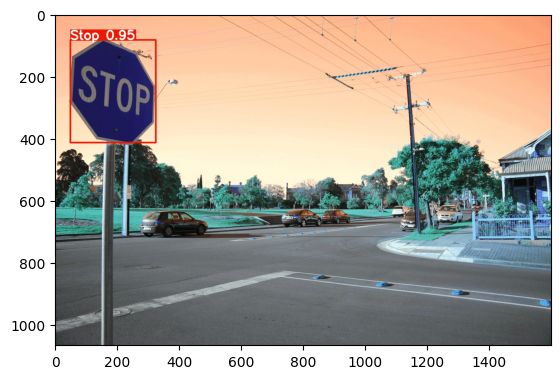

In [6]:
plt.imshow(result.plot())

In [9]:
result.boxes.data

tensor([[ 49.0521,  83.3675, 324.8391, 414.0314,   0.9467,  14.0000]], device='cuda:0')

## DETR and RT-DETR

Another approach to object detection is a usage of a different architecture - Transformers, that with additional tweaks could be applied to Computer Vision tasks.

The application of Transformers in Computer Vision tasks allows:

- to easier scale CV models;
- application of cross-modal data (different types such as text and visual) in one architecture;
- to decrease hand-designed techniques (such as anchors and NMS) and build completely end-to-end detection system.

At the moment, Transformer-based CV models are larger in size and use more resources than CNN-based models but due to their scalability they are more accurate and capable.

`DETR` is a tranformer-based model for object detection task. And for `realtime` detection `RT-DETR` is used.


In [1]:
from transformers import pipeline
from PIL import Image
import requests

detector50 = pipeline(model="facebook/detr-resnet-50", revision="no_timm")

2024-01-31 14:01:38.886412: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-01-31 14:01:38.886457: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-01-31 14:01:38.887694: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-01-31 14:01:38.894685: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-01-31 14:01:39.944530: W tensorflow/compiler/tf2

ninja: no work to do.


Loading extension module cuda_kernel...


![](http://images.cocodataset.org/val2017/000000039769.jpg)

In [2]:
url = "http://images.cocodataset.org/val2017/000000039769.jpg"
image = Image.open(requests.get(url, stream=True).raw)

results = detector50(url)
results

[{'score': 0.9982202649116516,
  'label': 'remote',
  'box': {'xmin': 40, 'ymin': 70, 'xmax': 175, 'ymax': 117}},
 {'score': 0.9960021376609802,
  'label': 'remote',
  'box': {'xmin': 333, 'ymin': 72, 'xmax': 368, 'ymax': 187}},
 {'score': 0.9954743981361389,
  'label': 'couch',
  'box': {'xmin': 0, 'ymin': 1, 'xmax': 639, 'ymax': 473}},
 {'score': 0.99880051612854,
  'label': 'cat',
  'box': {'xmin': 13, 'ymin': 52, 'xmax': 314, 'ymax': 470}},
 {'score': 0.9986783862113953,
  'label': 'cat',
  'box': {'xmin': 345, 'ymin': 23, 'xmax': 640, 'ymax': 368}}]

In [3]:
?detector50

Signature:      detector50(*args, **kwargs) -> List[Dict[str, Any]]
Type:           ObjectDetectionPipeline
String form:    <transformers.pipelines.object_detection.ObjectDetectionPipeline object at 0x7fb461935930>
File:           ~/Work/custom/.venv/lib/python3.10/site-packages/transformers/pipelines/object_detection.py
Docstring:     
Object detection pipeline using any `AutoModelForObjectDetection`. This pipeline predicts bounding boxes of objects
and their classes.

Example:

```python
>>> from transformers import pipeline

>>> detector = pipeline(model="facebook/detr-resnet-50")
>>> detector("https://huggingface.co/datasets/Narsil/image_dummy/raw/main/parrots.png")
[{'score': 0.997, 'label': 'bird', 'box': {'xmin': 69, 'ymin': 171, 'xmax': 396, 'ymax': 507}}, {'score': 0.999, 'label': 'bird', 'box': {'xmin': 398, 'ymin': 105, 'xmax': 767, 'ymax': 507}}]

>>> # x, y  are expressed relative to the top left hand corner.
```

Learn more about the basics of using a pipeline in the [pip

(-0.5, 639.5, 479.5, -0.5)

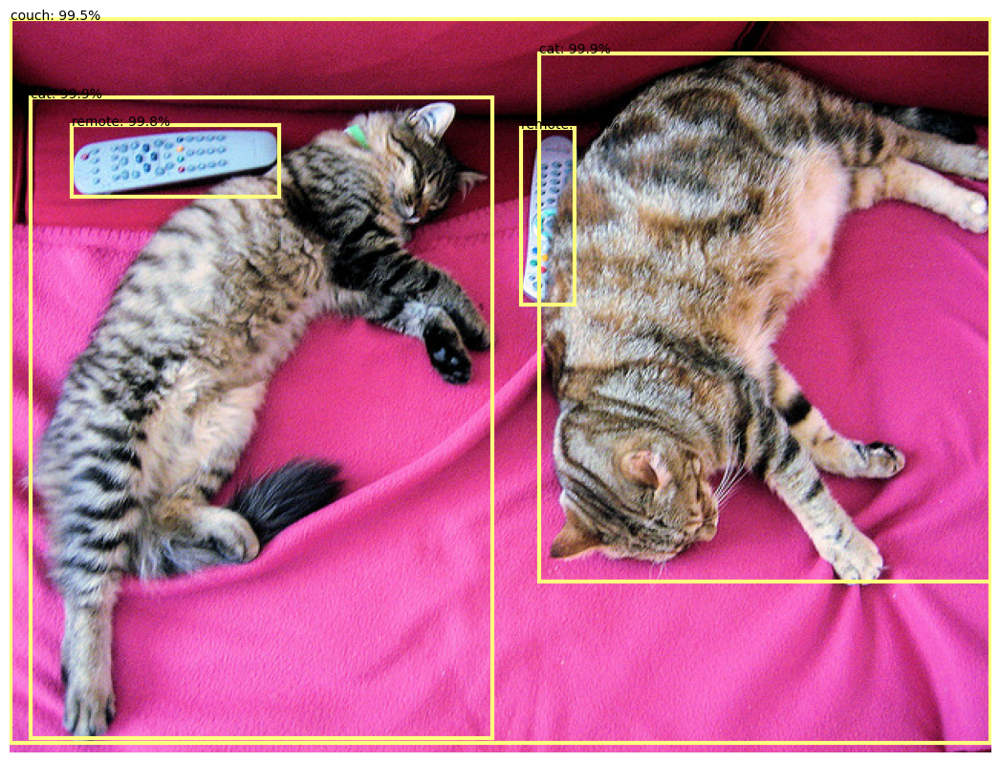

In [4]:
import matplotlib.pyplot as plt


plt.figure(figsize=(16, 10))
plt.imshow(image)
#pyplot.gcf()
ax = plt.gca()

for prediction in results:
    x, y = prediction['box']['xmin'], prediction['box']['ymin'],
    w, h = prediction['box']['xmax'] - prediction['box']['xmin'], prediction['box']['ymax'] - prediction['box']['ymin']

    ax.add_patch(plt.Rectangle((x, y), w, h, fill=False, color='#ffff7f', linewidth=3))
    ax.text(x, y, f"{prediction['label']}: {round(prediction['score']*100, 1)}%")

plt.axis("off")

HuggingFace proposes two approaches to the NN model inferences:

- compact with pre-defined pipeline using `pipeline` function that builds the whole inference workflow;
- customized workflow using abstractions for processors and models (e.g., [for DETR](https://huggingface.co/facebook/detr-resnet-50))

In [5]:
?pipeline

Signature:
pipeline(
    task: str = None,
    model: Union[str, ForwardRef('PreTrainedModel'), ForwardRef('TFPreTrainedModel'), NoneType] = None,
    config: Union[str, transformers.configuration_utils.PretrainedConfig, NoneType] = None,
    tokenizer: Union[str, transformers.tokenization_utils.PreTrainedTokenizer, ForwardRef('PreTrainedTokenizerFast'), NoneType] = None,
    feature_extractor: Union[str, ForwardRef('SequenceFeatureExtractor'), NoneType] = None,
    image_processor: Union[str, transformers.image_processing_utils.BaseImageProcessor, NoneType] = None,
    framework: Optional[str] = None,
    revision: Optional[str] = None,
    use_fast: bool = True,
    use_auth_token: Union[str, bool, NoneType] = None,
    device: Union[int, str, ForwardRef('torch.device'), NoneType] = None,
    device_map=None,
    torch_dtype=None,
    trust_remote_code: Optional[bool] = None,
    model_kwargs: Dict[str, Any] = None,
    pipeline_class: Optional[Any] = None,
    **kwargs,
) -> transfo

Tutorial for training DETR is [located here](https://huggingface.co/docs/transformers/tasks/object_detection).

## Metrics

For object detection tasks, the Mean Average Precision (mAP) metric is used. It leverages next metrics:

![Mean Average Precision](https://a.storyblok.com/f/139616/1200x800/e3195e34f1/map-elements.webp)

Intersection over Union (IoU) is used as threshold in Confusion Matrix to recieve binary decision whether object is detected or not.


![IoU threshold example usage](https://assets-global.website-files.com/5d7b77b063a9066d83e1209c/622fd6ab4d767309080d6e35_QFRd_4hu1JzqBoZXdyyTlSvyQvNkwVCFx9becbrmv8l6D_oZM_hnBzaSXrf8iSgf7H6DRntnvPkj0TuFfRzpHwxpI3JPffS845yQ2FSa4k1FU5KbGEvfHyclGWSvnD3YQHhXjhLu.png)

`Precision-Recall curve` is obtained by plotting the model's precision and recall values as a function of the model's confidence score threshold.

`Precision` is a measure of when "from all your model's predictions how often does it predicts correctly?". It indicates how much we can rely on the model's positive predictions. 

`Recall` is a measure of "has your model predicted correctly every time that it should have predicted?". It indicates any predictions that it should not have missed if the model is missing. 

The `Precision-Recall curve` encapsulates the tradeoff of both metrics and maximizes the effect of both metrics. It gives us a better idea of the overall accuracy of the model.

<br/>

The curve is build as correlation of Precision and Recall metrics for different model confidence thresholds (using specific IoU threshold).

![Precision-Recall curve](https://miro.medium.com/v2/resize:fit:4800/format:webp/1*GC4nLLTDq1eOP9njT6_INA.jpeg)

Such curve is calculated for each class, and `Average Precision (AP)` metric is used to aggregate the quality of the model throughout all thersholds. AP is calculated as `Area under the PR curve`.

To evaluate model as whole, the `Mean Average Precision (mAP)` is calculated.

<img src='https://a.storyblok.com/f/139616/1200x800/09681b30bf/map-formula.webp' width='70%'>

Ideal mAP is calculated for multiple IoU thresholds (starting from 0.5 to 0.95 with a step 0.05). It's notated as mAP or mAP.50:.05:.95.

But some approaches uses simple mAP at certain IoU thresholds (for YOLO it's mAP50).

# Image Segmentation

The goal of Image Segmentation is to segment image into regions and classify it. Basically, getting an image mask with a label assigned to each pixel.

Types of image segmentation:

![Types of segmentation](https://assets-global.website-files.com/5d7b77b063a9066d83e1209c/61252ce829671c254f13f6d0_an-overview-of-semantic-image-segmentation-4.png)

- Semantic - categorizes each pixel in an image into class
- Instance - identifies and separates individual objects within the image (detects boundaries of object and assigns a identidifier to each labeled object)
- Panoptic - combines semantic segmentation and instance segmentation; segments the image into semantically meaningful parts or regions, while also detecting and distinguishing individual instances of objects within those regions

<h3>Traditional image segmentation</h3>

Before raise in the DL methodology, there were certain way to perform Image Segmentation using algorithms.

Techniques used:

![Traditional segmentation list](https://assets-global.website-files.com/5d7b77b063a9066d83e1209c/61252d1629671c610b13f6f5_image-segmentation.png)

Examples of methods and code was described in the block [Image procesing](#image-processing).

<h3>Deep-learning based image segmentation</h3>

Deep learning techniques use neural network (e.g., CNN, ViT, etc.) to perform segmentation. 
Usually, they require a labeled dataset where label is a mask of the image with labeled pixels.

The basic architecture for image segmentation is `encoder-decoder` network. The encoder performs feature extraction; the decoder generates the final output (mask) that directly maps to the input image (by using FCN).

![Encoder-decoder arch](https://assets-global.website-files.com/5d7b77b063a9066d83e1209c/6114d9b889ba55c2ce882f8a_tVEj_AI9vFj89ZW6G21JHR2r6ZrZ18cvB6lt24-KeGmp9HozQwWACebWAbBJF4hVMQKxh_cMXkmtO2yJrfO3bkp-WNrRa-nTFBM8NPqI0_A3uz6V7hg_-MDy67NgTrzqcg6m-r93.png)

Additionally, one of the usual techniques in encoder-decoder network is a `skip connection`.

`Skip connections` are links that bypass one or more layers in a CNN and connect the output of an earlier layer to the input of a later layer. This way, the network can preserve some of the information from the previous layers and avoid losing it in the convolution and pooling operations.

It helps with vanishing gradient problem and introduces more complex and diverse features.

![Skip connections](https://theaisummer.com/static/2c373d3667071700748bf451c4e62b78/3accd/long-skip-connection.jpg)

## Semantic Segmentation

As mentioned before, semantic segmentation objective is to `classify the whole image into semantic regions`. 
If model is not trained on some object, it would label pixel as some other most similart class.

There are several approaches to this task:

- FCN (full-connected network) with CNN Backbone - e.g., FCN ResNet, Mobile-FCN, etc. (available in `torchvision` module); 
- U-Net - architecture that proposes addition of skip-connection and transpose convolutions;
- DeepLab - uses atrous convolution; available in `torchvision` module;
- transformers-based models - Swin, SegFormer, DINOv2, UperNet, Mask2Former; available in HuggingFace `transformers` module.



In [1]:
# Example of using pre-trained transformer model on COCO dataset

from transformers import SegformerImageProcessor, SegformerForSemanticSegmentation
import torch
import cv2
import matplotlib.pyplot as plt

checkpoint = "nvidia/segformer-b0-finetuned-ade-512-512"

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
processor = SegformerImageProcessor.from_pretrained(checkpoint)
model = SegformerForSemanticSegmentation.from_pretrained(checkpoint)
model.to(device)

2024-02-15 18:21:41.480252: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-02-15 18:21:41.480332: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-02-15 18:21:41.561510: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-02-15 18:21:41.724901: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-02-15 18:21:42.803587: W tensorflow/compiler/tf2

model.safetensors:   0%|          | 0.00/15.0M [00:00<?, ?B/s]

SegformerForSemanticSegmentation(
  (segformer): SegformerModel(
    (encoder): SegformerEncoder(
      (patch_embeddings): ModuleList(
        (0): SegformerOverlapPatchEmbeddings(
          (proj): Conv2d(3, 32, kernel_size=(7, 7), stride=(4, 4), padding=(3, 3))
          (layer_norm): LayerNorm((32,), eps=1e-05, elementwise_affine=True)
        )
        (1): SegformerOverlapPatchEmbeddings(
          (proj): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
          (layer_norm): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        )
        (2): SegformerOverlapPatchEmbeddings(
          (proj): Conv2d(64, 160, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
          (layer_norm): LayerNorm((160,), eps=1e-05, elementwise_affine=True)
        )
        (3): SegformerOverlapPatchEmbeddings(
          (proj): Conv2d(160, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
          (layer_norm): LayerNorm((256,), eps=1e-05, elementwise_affine=True)
  

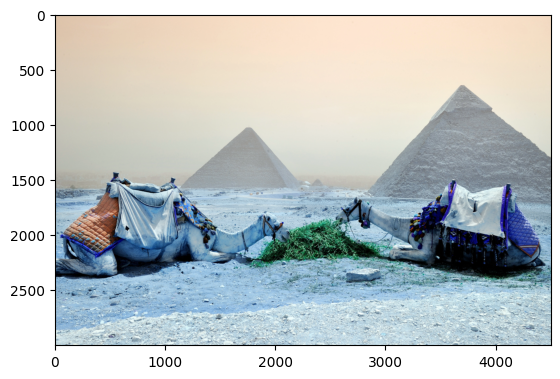

In [2]:
import matplotlib.pyplot as plt

image = cv2.imread('supplementary_data/camels1.jpg')
plt.imshow(image)

In [3]:
inputs = processor(images=image, return_tensors="pt").to(device)
outputs = model(**inputs)
outputs.keys()

odict_keys(['logits'])

In [8]:
outputs['logits'].shape

torch.Size([1, 150, 128, 128])

In [10]:
processed_output = processor.post_process_semantic_segmentation(outputs)[0]
processed_output

tensor([[ 2,  2,  2,  ...,  2,  2,  2],
        [ 2,  2,  2,  ...,  2,  2,  2],
        [ 2,  2,  2,  ...,  2,  2,  2],
        ...,
        [13, 13, 13,  ..., 13, 13, 13],
        [13, 13, 13,  ..., 13, 13, 13],
        [13, 13, 13,  ..., 13, 13, 13]], device='cuda:0')

In [11]:
processed_output.shape

torch.Size([128, 128])

In [30]:
model.config.id2label

{0: 'wall',
 1: 'building',
 2: 'sky',
 3: 'floor',
 4: 'tree',
 5: 'ceiling',
 6: 'road',
 7: 'bed ',
 8: 'windowpane',
 9: 'grass',
 10: 'cabinet',
 11: 'sidewalk',
 12: 'person',
 13: 'earth',
 14: 'door',
 15: 'table',
 16: 'mountain',
 17: 'plant',
 18: 'curtain',
 19: 'chair',
 20: 'car',
 21: 'water',
 22: 'painting',
 23: 'sofa',
 24: 'shelf',
 25: 'house',
 26: 'sea',
 27: 'mirror',
 28: 'rug',
 29: 'field',
 30: 'armchair',
 31: 'seat',
 32: 'fence',
 33: 'desk',
 34: 'rock',
 35: 'wardrobe',
 36: 'lamp',
 37: 'bathtub',
 38: 'railing',
 39: 'cushion',
 40: 'base',
 41: 'box',
 42: 'column',
 43: 'signboard',
 44: 'chest of drawers',
 45: 'counter',
 46: 'sand',
 47: 'sink',
 48: 'skyscraper',
 49: 'fireplace',
 50: 'refrigerator',
 51: 'grandstand',
 52: 'path',
 53: 'stairs',
 54: 'runway',
 55: 'case',
 56: 'pool table',
 57: 'pillow',
 58: 'screen door',
 59: 'stairway',
 60: 'river',
 61: 'bridge',
 62: 'bookcase',
 63: 'blind',
 64: 'coffee table',
 65: 'toilet',
 66: '

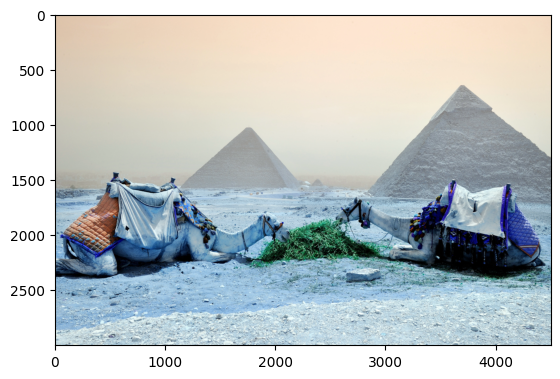

In [12]:
plt.imshow(image)

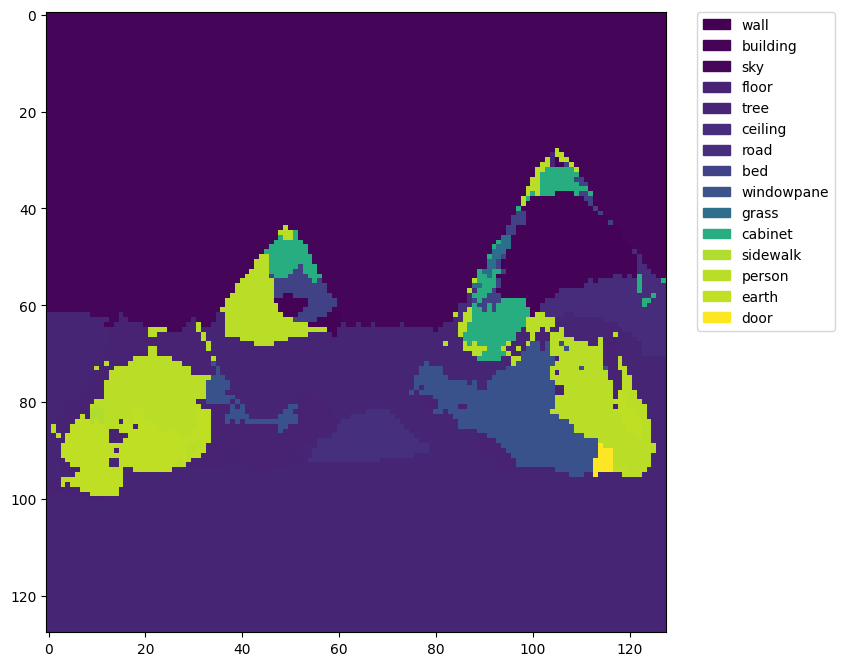

In [82]:
import matplotlib.patches as mpatches
import numpy as np

mask = processed_output.cpu().numpy()

plt.figure(figsize=(8, 10))
im = plt.imshow(mask, interpolation='none')
values = np.unique(mask.ravel())

colors = [ im.cmap(im.norm(value)) for value in values]
patches = [ mpatches.Patch(color=colors[i], label=model.config.id2label[i] ) for i in range(len(values)) ]
plt.legend(handles=patches, bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0. )

In [152]:
import matplotlib as mpl

values = np.unique(mask.ravel())
num_classes = max(model.config.id2label)
colors = [(mpl.colors.hsv_to_rgb((i / num_classes, 1, 1)) * 255).astype('uint8') for i in range(num_classes)]
patches = [ mpatches.Patch(color=colors[i]/255, label=model.config.id2label[i] ) for i in values ]

In [1]:
def draw_masks_fromList(image, masks_generated, colors):
    masked_image = image.copy()
    for i in np.unique(masks_generated.ravel()):
        mask = np.repeat((masks_generated == i).astype('uint8')[..., None], 3, axis=2)
        masked_image = np.where(mask,
                                colors[i],
                                masked_image)

        masked_image = masked_image.astype(np.uint8)

    return cv2.addWeighted(image, 0.3, masked_image, 0.4, 0)

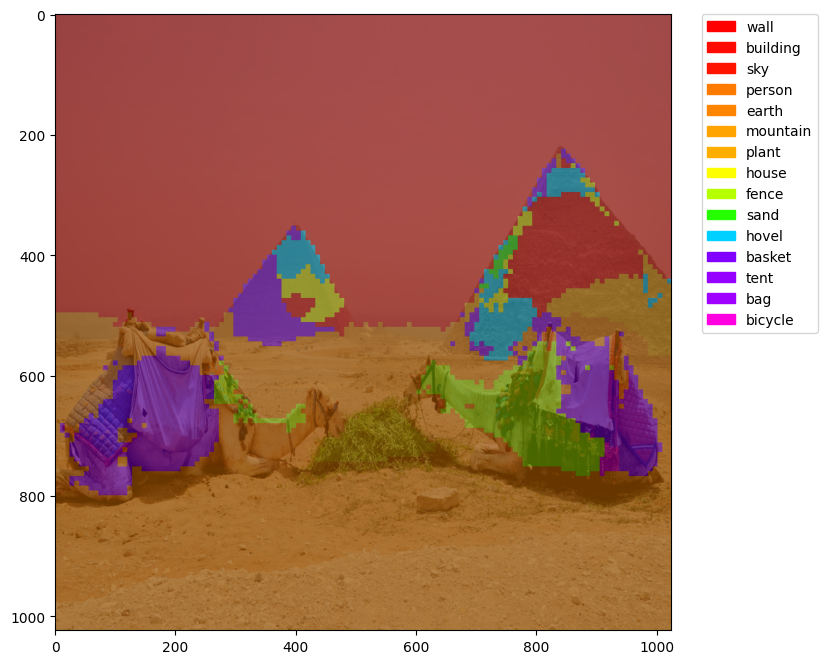

In [154]:
resized_img = cv2.resize(image, (1024, 1024), interpolation=cv2.INTER_AREA)
resized_img = cv2.cvtColor(resized_img, cv2.COLOR_BGR2RGB)
mask = cv2.resize(mask, (1024, 1024), interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(20,8))
plt.legend(handles=patches, bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0. )
plt.imshow(draw_masks_fromList(resized_img, mask, colors))

Training of Hugging Face Image Segmentation model is [described here](https://huggingface.co/docs/transformers/tasks/semantic_segmentation#fine-tuning-a-model-for-segmentation).

The list of available image segmentation models on the Hugging Face is [available here](https://huggingface.co/models?pipeline_tag=image-segmentation&sort=downloads).

In [13]:
from transformers import pipeline

In [14]:
seg_pipe = pipeline(model=checkpoint, task='image-segmentation')

Could not find image processor class in the image processor config or the model config. Loading based on pattern matching with the model's feature extractor configuration. Please open a PR/issue to update `preprocessor_config.json` to use `image_processor_type` instead of `feature_extractor_type`. This warning will be removed in v4.40.
/home/work/Work/custom/.venv/lib/python3.10/site-packages/transformers/models/segformer/image_processing_segformer.py:101: FutureWarning: The `reduce_labels` parameter is deprecated and will be removed in a future version. Please use `do_reduce_labels` instead.
  warnings.warn(


In [16]:
from PIL import Image

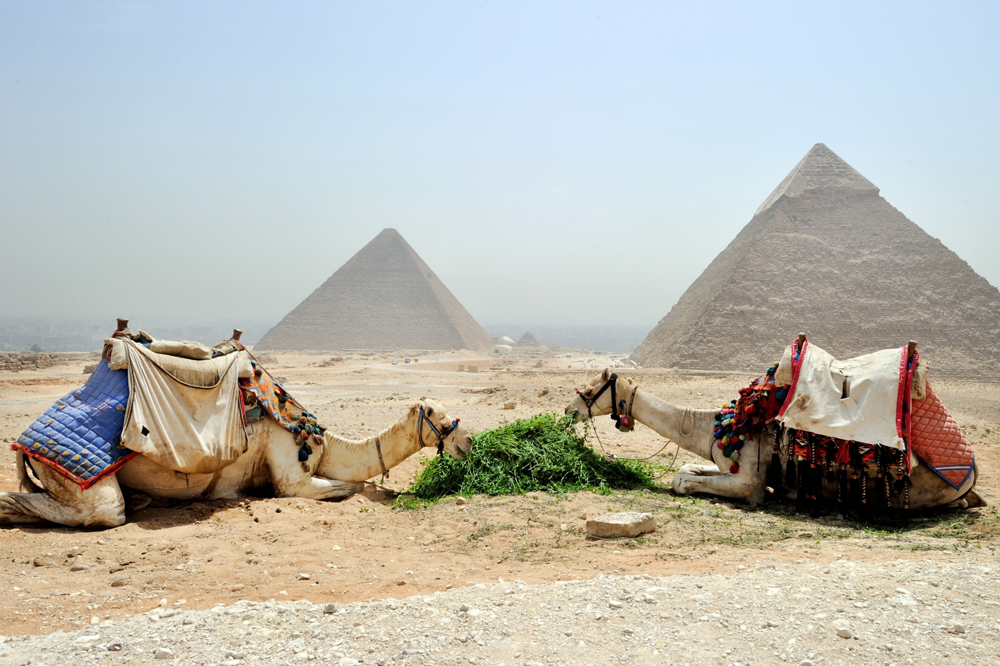

In [17]:
img = Image.open('supplementary_data/camels1.jpg')
img

In [22]:
processed_output.shape

torch.Size([128, 128])

In [18]:
seg_pipe(img)

[{'score': None,
  'label': 'wall',
  'mask': <PIL.Image.Image image mode=L size=4501x3000>},
 {'score': None,
  'label': 'building',
  'mask': <PIL.Image.Image image mode=L size=4501x3000>},
 {'score': None,
  'label': 'sky',
  'mask': <PIL.Image.Image image mode=L size=4501x3000>},
 {'score': None,
  'label': 'person',
  'mask': <PIL.Image.Image image mode=L size=4501x3000>},
 {'score': None,
  'label': 'earth',
  'mask': <PIL.Image.Image image mode=L size=4501x3000>},
 {'score': None,
  'label': 'mountain',
  'mask': <PIL.Image.Image image mode=L size=4501x3000>},
 {'score': None,
  'label': 'house',
  'mask': <PIL.Image.Image image mode=L size=4501x3000>},
 {'score': None,
  'label': 'fence',
  'mask': <PIL.Image.Image image mode=L size=4501x3000>},
 {'score': None,
  'label': 'hovel',
  'mask': <PIL.Image.Image image mode=L size=4501x3000>},
 {'score': None,
  'label': 'basket',
  'mask': <PIL.Image.Image image mode=L size=4501x3000>},
 {'score': None,
  'label': 'tent',
  'mask':

## Instance segmentation

Instance segmentation objective is very similar to the object detection - it looks for specific objects on the image and builds it's mask.

There are several approaches to the task:

- Mask R-CNN - uses Faster R-CNN to detect objects (bboxes) and build pixel mask for an object; available via `torchvision` module (in `references/detection`) or `detectron2` or `mmdetection`;
- YOLOv8 - similar to Mask R-CNN, available in `ultralytics` module;
- transformer-based - Mask2Former, available in Hugging Face `transformers` module.


Found https://ultralytics.com/images/bus.jpg locally at bus.jpg
image 1/1 /home/work/Work/custom/ds_camp_2023/lesson_30_applied_cv/bus.jpg: 640x480 4 persons, 1 bus, 1 skateboard, 73.5ms
Speed: 16.6ms preprocess, 73.5ms inference, 29.9ms postprocess per image at shape (1, 3, 640, 480)


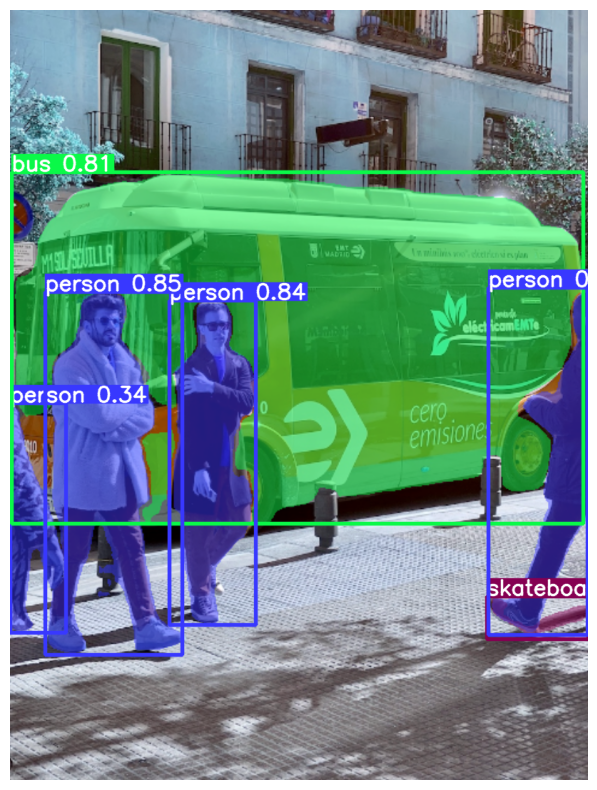

In [23]:
from ultralytics import YOLO
import matplotlib.pyplot as plt

# Load a model
model = YOLO('yolov8n-seg.pt')

# Predict with the model
results = model('https://ultralytics.com/images/bus.jpg')[0]
plt.figure(figsize=(8, 10))
plt.axis('off')
plt.imshow(results.plot())

In [25]:
type(results)

ultralytics.engine.results.Results

In [28]:
dir(results.masks)

['__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattr__',
 '__getattribute__',
 '__getitem__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__len__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 'cpu',
 'cuda',
 'data',
 'numpy',
 'orig_shape',
 'shape',
 'to',
 'xy',
 'xyn']

In [29]:
results.masks.data[0]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')

In [2]:
results.masks.data.shape
# each instance gets separate channel

torch.Size([6, 640, 480])

In [23]:
results.masks.xy[0].shape
# xy contains list of polygon coordinates

(245, 2)

In [28]:
results.boxes.cls

tensor([ 0.,  0.,  0.,  5.,  0., 36.], device='cuda:0')

[YOLO Instance Segmentation training](https://docs.ultralytics.com/tasks/segment/#train) is similar to YOLO Object Detection training.

1. The Dataset has to follow specific format specification:

    1. One text file with labels per image
    2. One row per object
    3. Row has to follow format below (and at least 3 xy points must be provided):
    
    ```
    <class-index> <x1> <y1> <x2> <y2> ... <xn> <yn>
    ```

2. Training script can be started using CLI command:

    ```bash
    yolo segment train data=coco128-seg.yaml model=yolov8n-seg.pt epochs=100 imgsz=640
    ```


## Panoptic segmentation

Panoptic segmentation segments the image into semantically meaningful parts or regions, while also detecting and distinguishing individual instances of objects within those regions

Approaches to panoptic segmentation:

- Panoptic FPN
- Mask2Former
- Panoptic SegFromer
- Mask DINO

In [33]:
import requests
import torch
from PIL import Image
from transformers import AutoImageProcessor, Mask2FormerForUniversalSegmentation

checkpoint = "facebook/mask2former-swin-base-coco-panoptic"

processor = AutoImageProcessor.from_pretrained(checkpoint)
model = Mask2FormerForUniversalSegmentation.from_pretrained(checkpoint)

![](http://images.cocodataset.org/val2017/000000039769.jpg)

In [4]:
url = "http://images.cocodataset.org/val2017/000000039769.jpg"
image = Image.open(requests.get(url, stream=True).raw)
inputs = processor(images=image, return_tensors="pt")

with torch.no_grad():
    outputs = model(**inputs)

result = processor.post_process_panoptic_segmentation(outputs, target_sizes=[image.size[::-1]])[0]
result.keys()

`label_ids_to_fuse` unset. No instance will be fused.


dict_keys(['segmentation', 'segments_info'])

In [34]:
model.config.id2label

{0: 'person',
 1: 'bicycle',
 2: 'car',
 3: 'motorcycle',
 4: 'airplane',
 5: 'bus',
 6: 'train',
 7: 'truck',
 8: 'boat',
 9: 'traffic light',
 10: 'fire hydrant',
 11: 'stop sign',
 12: 'parking meter',
 13: 'bench',
 14: 'bird',
 15: 'cat',
 16: 'dog',
 17: 'horse',
 18: 'sheep',
 19: 'cow',
 20: 'elephant',
 21: 'bear',
 22: 'zebra',
 23: 'giraffe',
 24: 'backpack',
 25: 'umbrella',
 26: 'handbag',
 27: 'tie',
 28: 'suitcase',
 29: 'frisbee',
 30: 'skis',
 31: 'snowboard',
 32: 'sports ball',
 33: 'kite',
 34: 'baseball bat',
 35: 'baseball glove',
 36: 'skateboard',
 37: 'surfboard',
 38: 'tennis racket',
 39: 'bottle',
 40: 'wine glass',
 41: 'cup',
 42: 'fork',
 43: 'knife',
 44: 'spoon',
 45: 'bowl',
 46: 'banana',
 47: 'apple',
 48: 'sandwich',
 49: 'orange',
 50: 'broccoli',
 51: 'carrot',
 52: 'hot dog',
 53: 'pizza',
 54: 'donut',
 55: 'cake',
 56: 'chair',
 57: 'couch',
 58: 'potted plant',
 59: 'bed',
 60: 'dining table',
 61: 'toilet',
 62: 'tv',
 63: 'laptop',
 64: 'mou

In [5]:
result['segments_info']

[{'id': 1, 'label_id': 15, 'was_fused': False, 'score': 0.998756},
 {'id': 2, 'label_id': 15, 'was_fused': False, 'score': 0.997873},
 {'id': 3, 'label_id': 65, 'was_fused': False, 'score': 0.997116},
 {'id': 4, 'label_id': 65, 'was_fused': False, 'score': 0.974273},
 {'id': 5, 'label_id': 57, 'was_fused': False, 'score': 0.956032}]

In [9]:
mask = result['segmentation']
mask.shape

torch.Size([480, 640])

In [21]:
import matplotlib as mpl
import numpy as np
import matplotlib.patches as mpatches
import matplotlib.pyplot as plt

num_classes = max(model.config.id2label)
colors = [(mpl.colors.hsv_to_rgb((i / num_classes, 1, 1)) * 255).astype('uint8') for i in range(num_classes)]
patches = [ mpatches.Patch(color=colors[val['label_id']]/255,
                           label=model.config.id2label[val['label_id']]) for val in result['segments_info'] ]

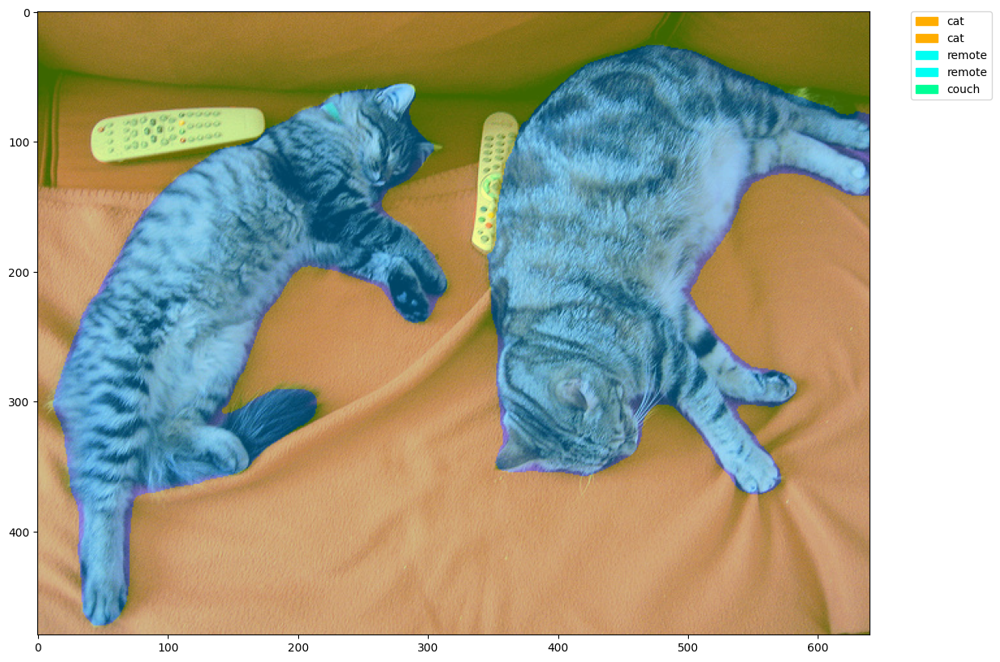

In [29]:
color_seg = np.zeros((mask.shape[0], mask.shape[1], 3), dtype=np.uint8)

for seg_info in result['segments_info']:
    color_seg[mask == seg_info['id'], :] = colors[seg_info['label_id']]

color_seg = color_seg[..., ::-1]
img = np.array(image) * 0.6 + color_seg * 0.4
img = img.astype(np.uint8)

plt.figure(figsize=(15, 10))
plt.imshow(img)
plt.legend(handles=patches, bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0. )
plt.show()

Details on how to fine-tune panoptic model such as MaskFormer can be found in [this notebook](https://github.com/NielsRogge/Transformers-Tutorials/blob/master/MaskFormer/Fine-tuning/Fine_tuning_MaskFormer_on_a_panoptic_dataset.ipynb).

In general, it's very similar to training regular Image Segmentation model.

## Segment Anything Model (SAM)

Zero-shot model that segments image either fully or based on supervised instructions (using points or boxes).
It doesn't provide labels, only masks in the area of interest.

So it's potential could be used in interactive segmentation (where user supervises the process of segmentation)
or 
in combination with other techniques (for example, with object detection that provides box as semi-automated labeling).


Example:

![SAM example](https://media.roboflow.com/notebooks/examples/segment-anything-model-paper.png)

Resources:

- [Demo](https://segment-anything.com/demo)
- [Original repository (PyTorch)](https://github.com/facebookresearch/segment-anything) ([inference example](https://github.com/facebookresearch/segment-anything/blob/main/notebooks/predictor_example.ipynb))
- [Ultralytics module](https://docs.ultralytics.com/models/sam), also contains Mobile and Fast versions
- [Semantic SAM repo](https://github.com/UX-Decoder/Semantic-SAM), allows to use SAM in different granularity (from semantic general level to part level)

# Visual embeddings and image retrieval

<h3>Intro</h3>

An `embedding` is a `vector representation` of some object.
For some time it was a representation of the word (text embedding), but with a progress of Computer Vision techniques, it became possible to create a visual embedding (vector representation of the image).

![Text embedding example](https://dkharazi.github.io/ecc71bb7c9e227b292dd909b02dbf4e8/embedding.svg)


An embedding can have any of the following interpretations:

- It uncovers a semantic meaning of the object in some high-dimensional space (vocabulary for words, feature space for othe kind of models)
- It approximates the similarity of certain objects in their common space
- It represents a hidden semantic relationship

<h3>How does it work</h3>

The main objective and challenge of any computer vision architecture is to transform raw data (pixel matrices) into usable features (feature extraction). That's what CNN networks are usually used for. 

And that's what leverages the possibility to create the visual embeddings.

Most classification models are built in the way that the all layers except the last one (which is a Linear, Full Connected) are used to perform feature extraction. And the last one performs final classification based on the transformed features.

![Simple CNN architecture](https://www.researchgate.net/publication/331152514/figure/fig1/AS:726915128254464@1550321480020/CNN-Feature-Extraction-for-the-handwritten-digit-image.ppm)


So, if the last layer is removed from the model, it's output would be the `vector of features` that would describe the image in some high-dimensional space - `visual embedding`.

## Image similarity

One of the tasks where visual embeddings are used is `Image similarity` task. Its main objective is to find the most similar candidate images based on a query image.

<h3>Approaches</h3>

The most important thing is how the model was trained - as this would be the main focus of feature extraction.

If the model was trained on several classes, it's hardly could be used to encode features of some other non-relevant objects.

So, depending on the task, there could be used 2 approaches:

1. If the task is to have a `general representation` of the image without specifics  - it's better to use `model that was pre-trained on large amount of classes` (e.g., COCO (81 classes) or ImageNet (1 or 21 thousand of classes)). Such models learn better about general and abstract features as the dataset was diversive.
2. If the task is to have a `speciailized model` (e.g., the one that could `encode great diversity of feature` of some specific objects) - it's might better to `train the model on those specific objects` (in case if diversive dataset with enough exists).

Examples:

<img src='supplementary_data/ring_orig.jpg' width='30%'>

<img src='supplementary_data/ring_recom.png' width='85%'>


<br/><br/>

<img src='supplementary_data/ring_2.jpg' width='50%'>

<img src='supplementary_data/ring_2_recom.png' width='85%'>


<h3>Similarities system pipeline</h3>

The pipeline consists of:

1. Having a model (using pre-trained or training custom) that would encode images into embeddings
2. Creating a vector database (e.g., in-memory list, FAISS, Pinecone, ElasticSearch, etc.) that would store embeddings of candidate images
3. Quering unseen image on vector database

<h3>Code</h3>

The following example of image similarity system is built using HuggingFace libraries as HF `datasets` module has simple interface to build vector dataset with FAISS algorithm. And using Visual Transformers as encoding model (could be switched to PyTorch).

In [1]:
!pip install transformers datasets faiss-gpu -q

In [2]:
from transformers import AutoFeatureExtractor, AutoModel
import torch

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

model_ckpt = "nateraw/vit-base-beans"
extractor = AutoFeatureExtractor.from_pretrained(model_ckpt)
model = AutoModel.from_pretrained(model_ckpt).to(device)
hidden_dim = model.config.hidden_size

2024-01-02 15:16:15.700339: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-01-02 15:16:16.776155: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
/home/work/Work/custom/.venv/lib/python3.10/site-packages/transformers/models/vit/feature_extraction_vit.py:28: FutureWarning: The class ViTFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use ViTImageProcessor instead.
  warnings.warn(
Some weights of ViTModel were not initialized from the model checkpoint at nateraw/vit-base-beans and are newly initialized: ['vit.pooler.dense.weight', 'vit.pooler.dense.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.

In [3]:
from datasets import load_dataset

dataset = load_dataset("beans")
dataset

Found cached dataset beans (/home/work/.cache/huggingface/datasets/beans/default/0.0.0/90c755fb6db1c0ccdad02e897a37969dbf070bed3755d4391e269ff70642d791)


  0%|          | 0/3 [00:00<?, ?it/s]

DatasetDict({
    train: Dataset({
        features: ['image_file_path', 'image', 'labels'],
        num_rows: 1034
    })
    validation: Dataset({
        features: ['image_file_path', 'image', 'labels'],
        num_rows: 133
    })
    test: Dataset({
        features: ['image_file_path', 'image', 'labels'],
        num_rows: 128
    })
})

In [4]:
def extract_embeddings(sample):
    """Function to extract embeddings from image."""
    image_pp = extractor(sample['image'], return_tensors="pt").to(device)
    features = model(**image_pp).last_hidden_state[:, 0].detach().cpu().numpy()
    return features.squeeze()

vector_db = dataset['train']
vector_db = vector_db.map(lambda x: {"embeddings": extract_embeddings(x)})
vector_db

Map:   0%|          | 0/1034 [00:00<?, ? examples/s]

Dataset({
    features: ['image_file_path', 'image', 'labels', 'embeddings'],
    num_rows: 1034
})

In [5]:
vector_db.add_faiss_index("embeddings")

  0%|          | 0/2 [00:00<?, ?it/s]

Dataset({
    features: ['image_file_path', 'image', 'labels', 'embeddings'],
    num_rows: 1034
})

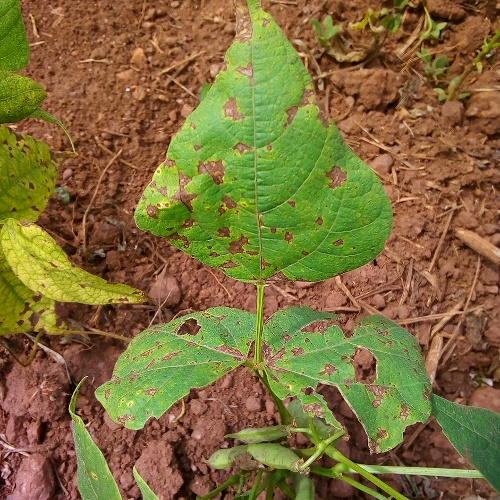

In [10]:
test_ds = dataset['test']

test_elem = test_ds[0]
test_elem['image']

In [18]:
test_embed = extract_embeddings(test_elem)
print(test_embed.shape)

scores, examples = vector_db.get_nearest_examples('embeddings', test_embed, k=5)
print(scores)
print(examples.keys())

(768,)
[2.323751  2.8621209 2.8910384 2.9509444 2.9870362]
dict_keys(['image_file_path', 'image', 'labels', 'embeddings'])


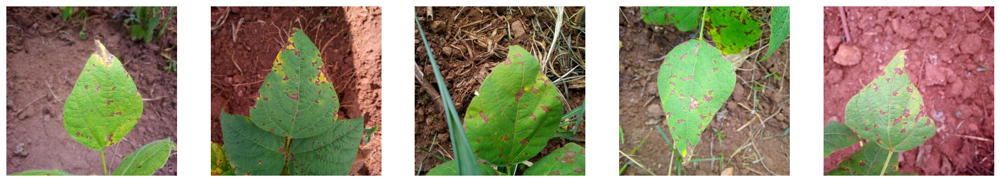

In [21]:
import matplotlib.pyplot as plt

fig, axs = plt.subplots(1, 5, figsize=(20, 10))

for i, img in enumerate(examples['image']):
    axs[i].imshow(img)
    axs[i].axis("off")

plt.show()

# Re-Identification and Object Tracking

Another task where visual embeddings are used is `Re-Identification` - a system where objects should be identified after registration. Usually, it's combined with a task of `Object Tracking` - where an object should be identified and tracked throughout the video or different cameras.

`Object Tracking` usually consists of an `object detection model` that detects object location on the image and methods that would allow to `keep track` of an object throughout the video. 

Example:

<img src='https://pylessons.com/media/Tutorials/YOLO-tutorials/YOLOv3-TF2-DeepSort/1.gif'>

Such methods are divided into 2 approaches - `location-based` (e.g., center distance, Kalman filter, etc.) and `feature-based` (using embeddings).

`Re-Identification` is an approach used to collect visual embeddings in order to identify the object (its features).

Example:

![Re-ID example](https://www.researchgate.net/publication/329116038/figure/fig1/AS:695611829518336@1542858192356/The-pipeline-of-person-re-identification.png)

Location-based approaches uses:

- center-based tracking (e.g., custom algorithm implementation or DL model such as CenterTrack);
- points-based tracking (e.g., JDE (joint detection and embedding model));
- complex-based tracking (e.g., SORT tracker that uses several algorithms)

One of the popular object tracking algorithm nowadays is `DeepSORT` that combines location-based method SORT and feature-based model that describes an object.

![Deep Sort](https://github.com/Ayushman-Choudhuri/yolov5-deepsort/blob/main/images/DeepSORT.png?raw=true)

Links:

[DeepSORT](https://github.com/levan92/deep_sort_realtime/tree/master)

[YOLO+DeepSORT](https://github.com/Ayushman-Choudhuri/yolov5-deepsort/tree/main)

[Torchereid](https://github.com/goksenin-uav/torchreid-pip)

# Optical Character Recognition (OCR)

`Optical Character Recognition` (OCR) is a technology that converts different types of documents, such as scanned paper documents, PDFs, or images captured by a digital camera, into editable and searchable text data.

Tools that perform recognition:

- Tesseract OCR (written on C++; available in Python as [pyTesseract](https://github.com/madmaze/pytesseract) - interface on C++ engine; contains 100+ languages)
- [EasyOCR](https://github.com/JaidedAI/EasyOCR) (written in Torch; contains 80+ languages)
- [TrOCR](https://github.com/NielsRogge/Transformers-Tutorials/tree/master/TrOCR) (Transformer-based architecture; available in `Hugging Face`; trained only for specific language but works better for handwritten text)
- cloud solutions

In [1]:
!pip install easyocr

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.9/2.9 MB 613.9 kB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.6/49.6 MB 563.6 kB/s eta 0:00:0000:0100:03
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.5/2.5 MB 612.7 kB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 307.2/307.2 KB 904.4 kB/s eta 0:00:00a 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 908.3/908.3 KB 965.2 kB/s eta 0:00:00a 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.7/14.7 MB 708.2 kB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 313.3/313.3 KB 639.9 kB/s eta 0:00:00a 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 223.6/223.6 KB 571.0 kB/s eta 0:00:00a 0:00:01


In [1]:
import easyocr

reader = easyocr.Reader(['en'])

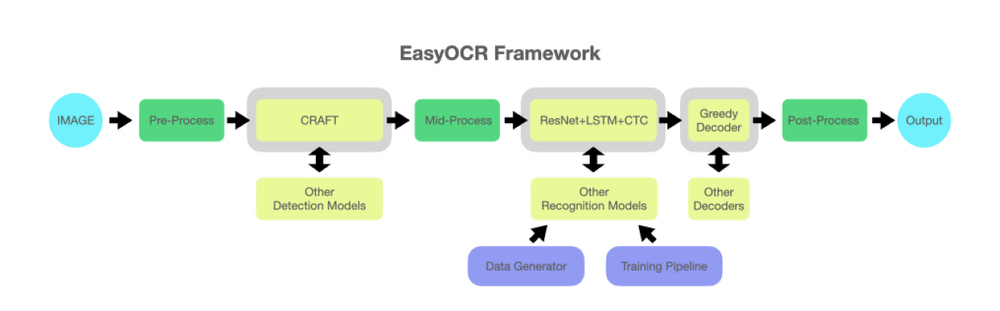

In [2]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import urllib.request as url_req


image_url = 'https://github.com/JaidedAI/EasyOCR/blob/master/examples/easyocr_framework.jpeg?raw=true'

req = url_req.urlopen(image_url)
nparr = np.asarray(bytearray(req.read()), dtype=np.uint8)
img = cv2.imdecode(nparr, cv2.IMREAD_COLOR)

plt.figure(figsize=(16, 10))
plt.axis('off')
plt.imshimage_url = 'https://github.com/JaidedAI/EasyOCR/blob/master/examples/easyocr_framework.jpeg?raw=true'
ow(img)

In [3]:
result = reader.readtext(img)
result

# list of box edges coordinates, text and model confidence

[([[393, 31], [606, 31], [606, 61], [393, 61]],
  'EasyOCR Framework',
  0.9931837603306735),
 ([[49, 107], [91, 107], [91, 123], [49, 123]], 'IMAGE', 0.9994574795622403),
 ([[143, 106], [213, 106], [213, 124], [143, 124]],
  'Pre-Process',
  0.8604036108111696),
 ([[297, 107], [339, 107], [339, 123], [297, 123]],
  'CRAFT',
  0.9990798379500605),
 ([[423, 107], [495, 107], [495, 123], [423, 123]],
  'Mid-Process',
  0.993505267443392),
 ([[539, 107], [653, 107], [653, 123], [539, 123]],
  'ResNet+LSTM+CTC',
  0.9314351812317798),
 ([[702, 100], [745, 100], [745, 117], [702, 117]],
  'Greedy',
  0.999935710443512),
 ([[820, 106], [867, 106], [867, 124], [820, 124]],
  'Process',
  0.9946323582579157),
 ([[910, 106], [953, 106], [953, 124], [910, 124]],
  'Output',
  0.9927288449679584),
 ([[699, 115], [749, 115], [749, 129], [699, 129]],
  'Decoder',
  0.9998304913925509),
 ([[301, 181], [335, 181], [335, 195], [301, 195]],
  'Other',
  0.9999500464946774),
 ([[579, 181], [615, 181], [

[Easy OCR's docs](https://github.com/JaidedAI/EasyOCR) contains additional information on module functionality.

# Keypoint Detection

Computer Vision task that aims at detecting specific `areas of interest` (`keypoints` or `landmarks`) and `their location` on the image, regardless image rotation, dsitortion or other transformation.
Usually, such points are associated with humans (most researched) or animals. But in general it could be applied to any objects.

Popular sub-tasks:

- Face Landmark Detection
- Pose Estimation
- Hand Pose Estimation


![Pose Estimation example](https://d3i71xaburhd42.cloudfront.net/170f822ec7d4ebb44991c5857229249a1e65fe43/1-Figure3-1.png)


## Face Landmark Detection

Aims at detecting face keypoints.

`MediaPipe` framework from Google contains a large amount of keypoints and has a fast inference.

Landmarks example from MediaPipe:

![Face landmarks from MediaPipe](https://developers.google.com/static/mediapipe/images/solutions/face_landmarker_keypoints.png)

In [1]:
!pip install mediapipe==0.10.0

# Download model weights
!wget -O face_landmarker_v2_with_blendshapes.task -q https://storage.googleapis.com/mediapipe-models/face_landmarker/face_landmarker/float16/1/face_landmarker.task

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 4.6 MB/s eta 0:00:00a 0:00:01
  Attempting uninstall: protobuf
    Found existing installation: protobuf 4.23.2
    Uninstalling protobuf-4.23.2:
      Successfully uninstalled protobuf-4.23.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
grpcio-status 1.54.2 requires protobuf>=4.21.6, but you have protobuf 3.20.3 which is incompatible.


In [4]:
import mediapipe as mp
from mediapipe.tasks import python
from mediapipe.tasks.python import vision
from mediapipe import solutions
from mediapipe.framework.formats import landmark_pb2

import numpy as np
import matplotlib.pyplot as plt
import cv2

import urllib.request as url_req

2024-01-16 16:07:27.311660: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-01-16 16:07:28.330533: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


In [14]:
base_options = python.BaseOptions(model_asset_path='face_landmarker_v2_with_blendshapes.task')
options = vision.FaceLandmarkerOptions(base_options=base_options,
                                       output_face_blendshapes=True,
                                       output_facial_transformation_matrixes=True,
                                       num_faces=1, )
detector = vision.FaceLandmarker.create_from_options(options)

W20240116 17:12:43.393729 33350 face_landmarker_graph.cc:169] Face blendshape model contains CPU only ops. Sets FaceBlendshapesGraph acceleration to Xnnpack.
INFO: Created TensorFlow Lite XNNPACK delegate for CPU.


(-0.5, 1023.5, 1023.5, -0.5)

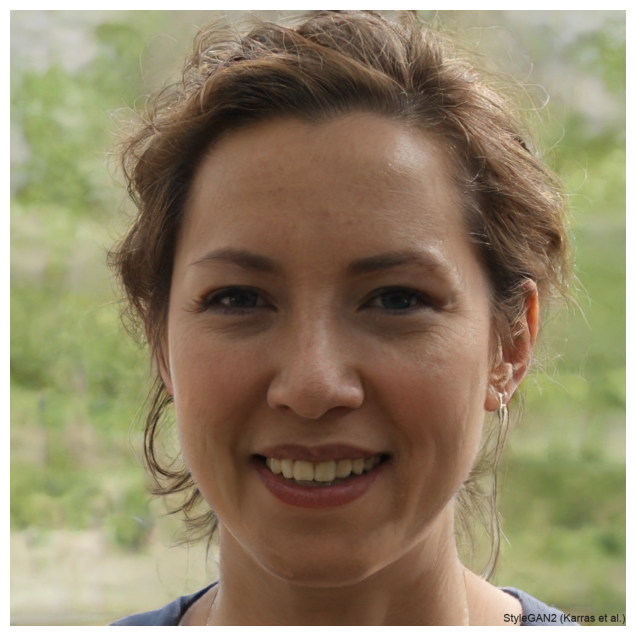

In [37]:
image_url = 'https://thispersondoesnotexist.com/'
hdr = {
    'User-Agent': 'Mozilla/5.0 (X11; Linux x86_64) AppleWebKit/537.11 (KHTML, like Gecko) Chrome/23.0.1271.64 Safari/537.11',
    'Accept': 'text/html,application/xhtml+xml,application/xml;q=0.9,*/*;q=0.8',
    }

req = url_req.urlopen(url_req.Request(image_url, headers=hdr))
nparr = np.asarray(bytearray(req.read()), dtype=np.uint8)
image = cv2.imdecode(nparr, cv2.IMREAD_COLOR)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

plt.figure(figsize=(12, 8))
plt.imshow(image)
plt.axis('off')

In [38]:
mp_image = mp.Image(image_format=mp.ImageFormat.SRGB, data=image)
face_landmarks_list = detector.detect(mp_image).face_landmarks

face_landmarks_list

[[NormalizedLandmark(x=0.49067842960357666, y=0.7115824222564697, z=-0.061471935361623764, visibility=0.0, presence=0.0),
  NormalizedLandmark(x=0.48366543650627136, y=0.6433773040771484, z=-0.13682621717453003, visibility=0.0, presence=0.0),
  NormalizedLandmark(x=0.48884546756744385, y=0.6626454591751099, z=-0.07132131606340408, visibility=0.0, presence=0.0),
  NormalizedLandmark(x=0.4676905572414398, y=0.5584262609481812, z=-0.10759706795215607, visibility=0.0, presence=0.0),
  NormalizedLandmark(x=0.48328697681427, y=0.617098867893219, z=-0.14654795825481415, visibility=0.0, presence=0.0),
  NormalizedLandmark(x=0.48481321334838867, y=0.5831190943717957, z=-0.1395135521888733, visibility=0.0, presence=0.0),
  NormalizedLandmark(x=0.49006178975105286, y=0.5009983777999878, z=-0.07964449375867844, visibility=0.0, presence=0.0),
  NormalizedLandmark(x=0.3400680720806122, y=0.48047709465026855, z=0.036911774426698685, visibility=0.0, presence=0.0),
  NormalizedLandmark(x=0.491092026233

(-0.5, 1023.5, 1023.5, -0.5)

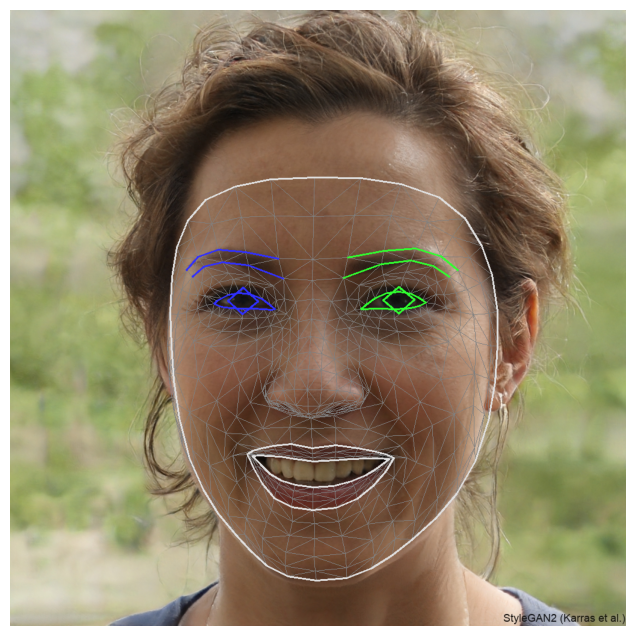

In [40]:
for idx in range(len(face_landmarks_list)):
    face_landmarks = face_landmarks_list[idx]

    face_landmarks_proto = landmark_pb2.NormalizedLandmarkList()
    face_landmarks_proto.landmark.extend([
        landmark_pb2.NormalizedLandmark(x=landmark.x, y=landmark.y, z=landmark.z) for landmark in face_landmarks
    ])

    solutions.drawing_utils.draw_landmarks(
        image=image,
        landmark_list=face_landmarks_proto,
        connections=mp.solutions.face_mesh.FACEMESH_TESSELATION,
        landmark_drawing_spec=None,
        connection_drawing_spec=mp.solutions.drawing_styles
        .get_default_face_mesh_tesselation_style())

    solutions.drawing_utils.draw_landmarks(
        image=image,
        landmark_list=face_landmarks_proto,
        connections=mp.solutions.face_mesh.FACEMESH_CONTOURS,
        landmark_drawing_spec=None,
        connection_drawing_spec=mp.solutions.drawing_styles
        .get_default_face_mesh_contours_style())

    solutions.drawing_utils.draw_landmarks(
        image=image,
        landmark_list=face_landmarks_proto,
        connections=mp.solutions.face_mesh.FACEMESH_IRISES,
            landmark_drawing_spec=None,
            connection_drawing_spec=mp.solutions.drawing_styles
            .get_default_face_mesh_iris_connections_style())


plt.figure(figsize=(12, 8))
plt.imshow(image)
plt.axis('off')

## Hand Landmark Detection

Aims at detecting hands and it's keypoints.

MediaPipe example:

![MediaPipe example](https://developers.google.com/static/mediapipe/images/solutions/hand-landmarks.png)

In [1]:
!wget -q https://storage.googleapis.com/mediapipe-models/hand_landmarker/hand_landmarker/float16/1/hand_landmarker.task

In [2]:
import mediapipe as mp
from mediapipe.tasks import python
from mediapipe.tasks.python import vision
from mediapipe import solutions
from mediapipe.framework.formats import landmark_pb2

import numpy as np
import matplotlib.pyplot as plt
import cv2

import urllib.request as url_req

2024-01-17 11:46:59.318104: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2024-01-17 11:46:59.623909: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2024-01-17 11:46:59.625571: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-01-17 11:47:00.802591: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


In [3]:
base_options = python.BaseOptions(model_asset_path='hand_landmarker.task')
options = vision.HandLandmarkerOptions(base_options=base_options,
                                       num_hands=2)
detector = vision.HandLandmarker.create_from_options(options)

INFO: Created TensorFlow Lite XNNPACK delegate for CPU.


(-0.5, 1231.5, 820.5, -0.5)

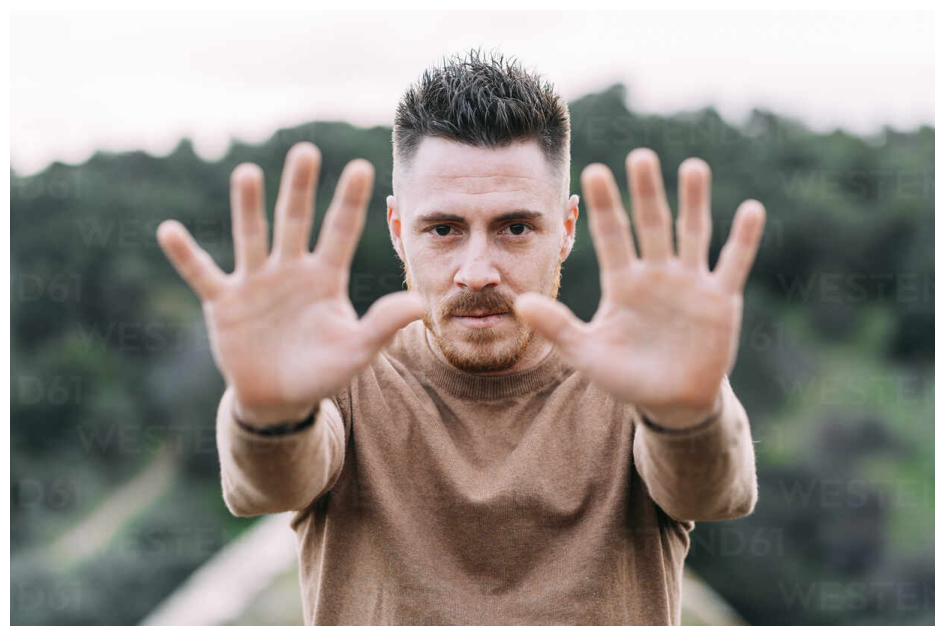

In [4]:
image_url = "https://us.images.westend61.de/0001537643pw/man-showing-palm-of-hands-DAMF00763.jpg"

req = url_req.urlopen(image_url)
nparr = np.asarray(bytearray(req.read()), dtype=np.uint8)
image = cv2.imdecode(nparr, cv2.IMREAD_COLOR)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

plt.figure(figsize=(12, 8))
plt.imshow(image)
plt.axis('off')

In [6]:
mp_image = mp.Image(image_format=mp.ImageFormat.SRGB, data=image)
detection_result = detector.detect(mp_image)
hand_landmarks_list = detection_result.hand_landmarks
handedness_list = detection_result.handedness

hand_landmarks_list, handedness_list

([[NormalizedLandmark(x=0.2852229177951813, y=0.6405277252197266, z=2.2756513828880998e-07, visibility=0.0, presence=0.0),
   NormalizedLandmark(x=0.3375813066959381, y=0.6062558889389038, z=-0.024781042709946632, visibility=0.0, presence=0.0),
   NormalizedLandmark(x=0.3780970871448517, y=0.5443090796470642, z=-0.03573396056890488, visibility=0.0, presence=0.0),
   NormalizedLandmark(x=0.4082814157009125, y=0.49881550669670105, z=-0.04601495712995529, visibility=0.0, presence=0.0),
   NormalizedLandmark(x=0.4407315254211426, y=0.48149821162223816, z=-0.05789478123188019, visibility=0.0, presence=0.0),
   NormalizedLandmark(x=0.34199026226997375, y=0.44139790534973145, z=-0.03188430890440941, visibility=0.0, presence=0.0),
   NormalizedLandmark(x=0.3601721525192261, y=0.35818126797676086, z=-0.05099298059940338, visibility=0.0, presence=0.0),
   NormalizedLandmark(x=0.3707130253314972, y=0.30960553884506226, z=-0.06529819220304489, visibility=0.0, presence=0.0),
   NormalizedLandmark(x

(-0.5, 1231.5, 820.5, -0.5)

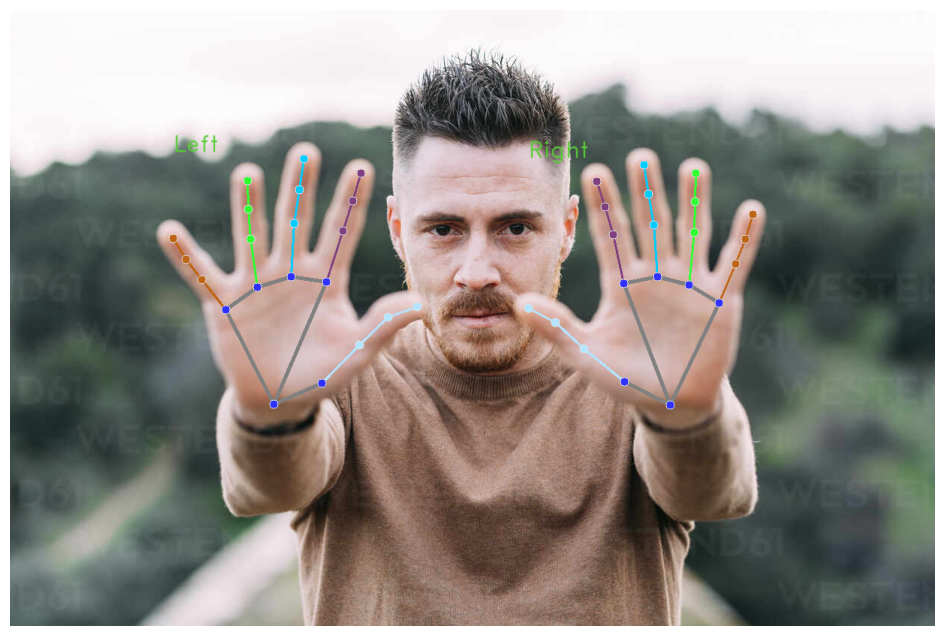

In [7]:
for idx in range(len(hand_landmarks_list)):
    hand_landmarks = hand_landmarks_list[idx]
    handedness = handedness_list[idx]

    # Draw the hand landmarks.
    hand_landmarks_proto = landmark_pb2.NormalizedLandmarkList()
    hand_landmarks_proto.landmark.extend([
        landmark_pb2.NormalizedLandmark(x=landmark.x, y=landmark.y, z=landmark.z) for landmark in hand_landmarks
    ])
    solutions.drawing_utils.draw_landmarks(
        image,
        hand_landmarks_proto,
        solutions.hands.HAND_CONNECTIONS,
        solutions.drawing_styles.get_default_hand_landmarks_style(),
        solutions.drawing_styles.get_default_hand_connections_style())

    # Get the top left corner of the detected hand's bounding box.
    height, width, _ = image.shape
    x_coordinates = [landmark.x for landmark in hand_landmarks]
    y_coordinates = [landmark.y for landmark in hand_landmarks]
    text_x = int(min(x_coordinates) * width)
    text_y = int(min(y_coordinates) * height) - 10

    # Draw handedness (left or right hand) on the image.
    cv2.putText(image, f"{handedness[0].category_name}",
                (text_x, text_y), cv2.FONT_HERSHEY_DUPLEX,
                1, (88, 205, 54), 1, cv2.LINE_AA)

plt.figure(figsize=(12, 8))
plt.imshow(image)
plt.axis('off')

## Pose Estimation

Aims at detecting person's pose (it's skeleton).

MediaPipe's example:

<img src='https://developers.google.com/static/mediapipe/images/solutions/pose_landmarks_index.png' width='60%'>

In [1]:
!wget -O pose_landmarker.task -q https://storage.googleapis.com/mediapipe-models/pose_landmarker/pose_landmarker_heavy/float16/1/pose_landmarker_heavy.task

In [6]:
import mediapipe as mp
from mediapipe.tasks import python
from mediapipe.tasks.python import vision

from mediapipe import solutions
from mediapipe.framework.formats import landmark_pb2
import numpy as np

import numpy as np
import matplotlib.pyplot as plt
import cv2

import urllib.request as url_req

In [2]:
base_options = python.BaseOptions(model_asset_path='pose_landmarker.task')
options = vision.PoseLandmarkerOptions(
    base_options=base_options,
    output_segmentation_masks=True)
detector = vision.PoseLandmarker.create_from_options(options)

INFO: Created TensorFlow Lite XNNPACK delegate for CPU.


(-0.5, 3466.5, 5199.5, -0.5)

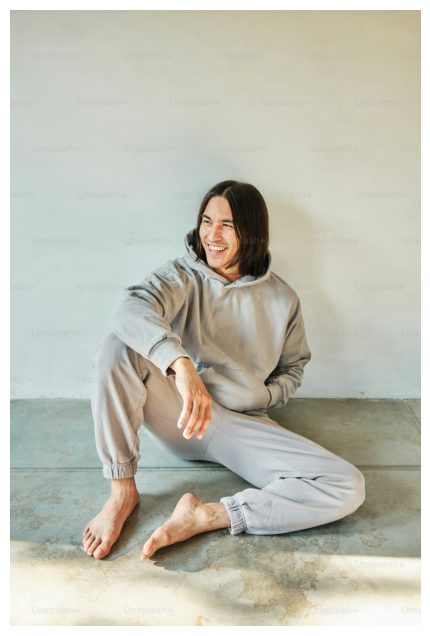

In [31]:
image_url = "https://plus.unsplash.com/premium_photo-1689327920989-46ae447a2f01"

req = url_req.urlopen(image_url)
nparr = np.asarray(bytearray(req.read()), dtype=np.uint8)
image = cv2.imdecode(nparr, cv2.IMREAD_COLOR)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)


plt.figure(figsize=(12, 8))
plt.imshow(image)
plt.axis('off')

In [4]:
mp_image = mp.Image(image_format=mp.ImageFormat.SRGB, data=image)
detection_result = detector.detect(mp_image)
pose_landmarks_list = detection_result.pose_landmarks
pose_landmarks_list

[[NormalizedLandmark(x=0.4935709238052368, y=0.3673982322216034, z=-0.09458520263433456, visibility=0.9999810457229614, presence=0.9999982118606567),
  NormalizedLandmark(x=0.5184880495071411, y=0.35031476616859436, z=-0.05485294386744499, visibility=0.9999552965164185, presence=0.9999929666519165),
  NormalizedLandmark(x=0.5308855772018433, y=0.351438045501709, z=-0.05513580143451691, visibility=0.9999256134033203, presence=0.9999899864196777),
  NormalizedLandmark(x=0.5418661832809448, y=0.35357263684272766, z=-0.054901253432035446, visibility=0.9999481439590454, presence=0.9999840259552002),
  NormalizedLandmark(x=0.49194130301475525, y=0.3495413064956665, z=-0.04059998318552971, visibility=0.9999802112579346, presence=0.9999953508377075),
  NormalizedLandmark(x=0.48654797673225403, y=0.34930992126464844, z=-0.04131922498345375, visibility=0.9999847412109375, presence=0.999996542930603),
  NormalizedLandmark(x=0.4811449646949768, y=0.34896525740623474, z=-0.041582267731428146, visib

(-0.5, 3466.5, 5199.5, -0.5)

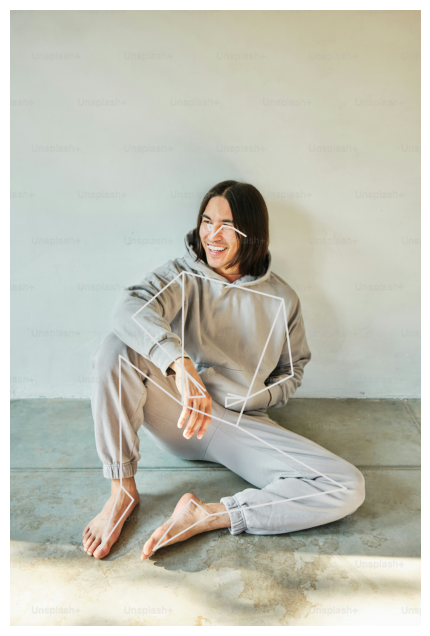

In [32]:
for idx in range(len(pose_landmarks_list)):
    pose_landmarks = pose_landmarks_list[idx]

    # Draw the pose landmarks.
    pose_landmarks_proto = landmark_pb2.NormalizedLandmarkList()
    pose_landmarks_proto.landmark.extend([
        landmark_pb2.NormalizedLandmark(x=landmark.x, y=landmark.y, z=landmark.z) for landmark in pose_landmarks
    ])
    solutions.drawing_utils.draw_landmarks(
        image,
        pose_landmarks_proto,
        solutions.pose.POSE_CONNECTIONS,
        solutions.drawing_styles.DrawingSpec(thickness=3),
        solutions.drawing_styles.DrawingSpec(thickness=15)

    )
        # solutions.drawing_styles.get_default_pose_landmarks_style())

plt.figure(figsize=(12, 8))
plt.imshow(image)
plt.axis('off')

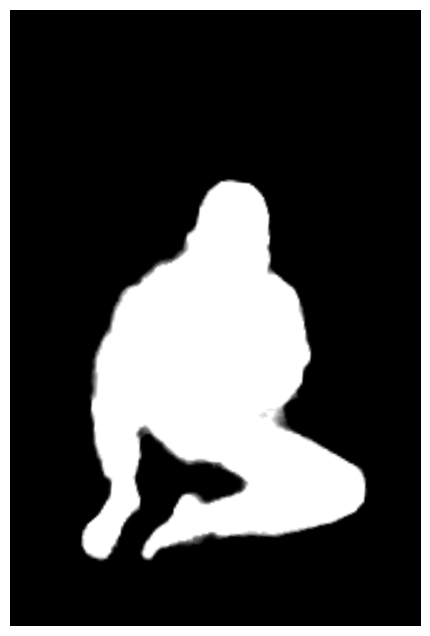

In [11]:
segmentation_mask = detection_result.segmentation_masks[0].numpy_view()
plt.figure(figsize=(12, 8))
plt.axis('off')
plt.imshow(segmentation_mask, cmap='gray')

# Computer Vision Libraries

## OpenMMLab

`OpenMMLab` is one of largest `open-source communities` that build computer vision algorithm system.

Based on `PyTorch`, OpenMMLab develops `MMEngine` to provide `universal training and evaluation engine`, and MMCV to provide neural network operators and data transforms, which serves as a foundation of the whole project. Since the initial release in October 2018, OpenMMLab has released 30+ vision libraries, has implemented 300+ algorithms, and contains 2000+ pre-trained models.

MMLab Toolset:

![MMLab toolset](https://user-images.githubusercontent.com/40779233/187065730-1e9af236-37dc-4dbd-b448-cce3b72b0109.png)



Projects that are officially supported and endorsed by OpenMMLab - [OpenMMLab codebase on their site](https://openmmlab.com/codebase).

In [8]:
!pip install -U openmim
!mim install mmengine

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.7/52.7 KB 500.1 kB/s eta 0:00:00a 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 1.6 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 299.2/299.2 KB 3.8 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 239.4/239.4 KB 3.5 MB/s eta 0:00:00a 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 259.5/259.5 KB 3.5 MB/s eta 0:00:00a 0:00:01
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 953.1/953.1 KB 2.1 MB/s eta 0:00:00a 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 443.0/443.0 KB 2.2 MB/s eta 0:00:00a 0:00:01
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 94.0/94.0 KB 3.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.7/89.7 KB 2.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for oss2: filename=oss2-2.17.0-py3-none-any.whl size=112394 sha256=760b5

In [9]:
!python -c 'from mmengine.utils.dl_utils import collect_env;print(collect_env())'

OrderedDict([('sys.platform', 'linux'), ('Python', '3.10.12 (main, Nov 20 2023, 15:14:05) [GCC 11.4.0]'), ('CUDA available', True), ('MUSA available', False), ('numpy_random_seed', 2147483648), ('GPU 0', 'NVIDIA GeForce GTX 1650'), ('CUDA_HOME', '/usr/local/cuda'), ('NVCC', 'Cuda compilation tools, release 12.0, V12.0.76'), ('GCC', 'x86_64-linux-gnu-gcc (Ubuntu 11.4.0-1ubuntu1~22.04) 11.4.0'), ('PyTorch', '2.0.0+cu117'), ('PyTorch compiling details', 'PyTorch built with:\n  - GCC 9.3\n  - C++ Version: 201703\n  - Intel(R) oneAPI Math Kernel Library Version 2022.2-Product Build 20220804 for Intel(R) 64 architecture applications\n  - Intel(R) MKL-DNN v2.7.3 (Git Hash 6dbeffbae1f23cbbeae17adb7b5b13f1f37c080e)\n  - OpenMP 201511 (a.k.a. OpenMP 4.5)\n  - LAPACK is enabled (usually provided by MKL)\n  - NNPACK is enabled\n  - CPU capability usage: AVX2\n  - CUDA Runtime 11.7\n  - NVCC architecture flags: -gencode;arch=compute_37,code=sm_37;-gencode;arch=compute_50,code=sm_50;-gencode;arch=co

OpenMMLab covers a lot of computer vision tasks and any information about it can be found on module corresponding to the task on their site or repo. Please, refer to it in case you want to build a system using it.

Meanwhile, simple pre-trained demo is accessible in [this demo file](open_mmlab_pretrained_demo.py).

In [ ]:
!git clone https://github.com/open-mmlab/mmpretrain.git
!cd mmpretrain
!pip install -U openmim && mim install -e .
!mim install -e ".[multimodal]"
!pip install "gradio==3.41.0"

## Detectron2

`Detectron2` is Facebook AI Research's library that provides state-of-the-art detection and segmentation algorithms.

Functionality that Detectron2 offers:

<img src='https://user-images.githubusercontent.com/1381301/66535560-d3422200-eace-11e9-9123-5535d469db19.png'>

In [ ]:
!pip install 'git+https://github.com/facebookresearch/detectron2.git'

## HuggingFace

One of the largest DL-oriented libraries that mostly covers transformers-based algorithms but still offers a lot of other tools:

1. First of all, it contains a `diffusion` library that covers subject of image generative AI - unconditional and conditional (using text or images) generation. It covers such models as `GANs` (generative adversial networks) and `LDMs` (latent diffusion models) with `finetuning methods such as DreamBooth and LoRA`.
2. The `transformers` library has a lot of models and approaches for Computer Vision tasks as shown above for some examples. 

# Summary

Tasks of Computer Vision domain:

- `image processing`:

    * Objective - transform images using convential algorithms and tools (usually required for pre-/post-processing, also could be used for Image Augmentation)
    * Tools - OpenCV, PIL, transforms (torchvision module), mmcv (from OpenMMLab eco-system)

- `image classification`:

    * Objective - classify the whole image to specific group
    * Architectures - ResNet, MobileNet, YOLO, SwinTransformer, ViT
    * Tools - torchvision, transformers (from HuggingFace), mmcv and mmpretrain (fgrom OpenMMLab eco-system)

- `object detection`:

    * Objective - detect and classify objects on the image using bounding box (rectangle area)
    * Architectures - Faster R-CNN, YOLO, DETR
    * Tools - ultralytics, detectron2, transformers, mmdetection and mmyolo (from OpenMMLab eco-system)

- `semantic segmentation`:

    * Objective - classify every pixel of the image to specific group
    * Architectures - UNet, DeepLab, SwinTransformer, SegFormer
    * Tools - torchvision, mmsegmentation (from OpenMMLab eco-system), transformers (from HuggingFace)

- `instance segmentation`:

    * Objective - locate and classify object on the image as mask (polygon)
    * Architectures - YOLO, Mask R-CNN, Mask2Former
    * Tools - ultralytics, torchvision, detectron2, mmdetection, transformers

- `panoptic segmentation`:

    * Objective - classify every pixel of the image and identify different objects
    * Architectures - Panoptic FPN, Mask2Former, Panoptic SegFormer, DINO
    * Tools - detectron2, mmdetectron, transformers

- `image retrieval`:

    * Objective - encode image into feature vector (embedding)
    * Architectures - image classification (backbones) - ResNet, ViT, SwinTransformer
    * Tools - torchvision, mmoretrain and mmcv, transformers

- `object tracking`:

    * Objective - identify and\or track objects throughout continuous workflow
    * Tools - DeepSORT, TorchReID

- `optical character recognition`:

    * Objective - recognise symbols on the image
    * Architectures - ML algorithms, CNN, TrOCR
    * Tools - pytesseract, easyocr, transformers (from HuggingFace), mmocr (from OpenMMLab eco-system)

- `keypoint detection`:

    * Objective - detect specific keypoints for an object
    * Architectures - Hourglass, ViT-Pose, Keypoint R-CNN
    * Tools - detectron2, torchvision, mmpose, mediapipe (proprietary)


# References and materials

1. [TorchVision models](https://pytorch.org/vision/stable/models.html)
2. [TorchVision transforms](https://pytorch.org/vision/stable/transforms.html)
3. [TorchVision training references](https://github.com/pytorch/vision/tree/main/references)
4. [R-CNN](https://kikaben.com/faster-r-cnn-rpn/#how-rpn-produces-region-proposals)
5. [R-CNN 2](https://towardsdatascience.com/r-cnn-fast-r-cnn-faster-r-cnn-yolo-object-detection-algorithms-36d53571365e)
6. [NMS](https://builtin.com/machine-learning/non-maximum-suppression)
7. [YOLO paper](https://arxiv.org/pdf/1506.02640v5.pdf)
8. [YOLO article](https://www.datacamp.com/blog/yolo-object-detection-explained)
9. [YOLO article 2](https://dkharazi.github.io/notes/ml/cnn/yolo)
10. [Anchors](https://www.thinkautonomous.ai/blog/anchor-boxes/)
11. [mAP](https://www.v7labs.com/blog/mean-average-precision#what-is-mean-average-precision-map)
12. [Image Similarity](https://huggingface.co/blog/image-similarity)
13. [DeepSORT](https://github.com/levan92/deep_sort_realtime/tree/master)
14. [YOLO+DeepSORT](https://github.com/Ayushman-Choudhuri/yolov5-deepsort/tree/main)
15. [Torchereid](https://github.com/goksenin-uav/torchreid-pip)
16. [PyTorch FCN CNN](https://pytorch.org/hub/pytorch_vision_fcn_resnet101/)
17. [Mask2Former](https://github.com/NielsRogge/Transformers-Tutorials/tree/master/MaskFormer)
18. [Segmentation SOTA - OneFormer](https://github.com/SHI-Labs/OneFormer)
19. [Image Similarity](https://huggingface.co/blog/image-similarity)
20. [DeepSORT](https://github.com/levan92/deep_sort_realtime/tree/master)
21. [YOLO+DeepSORT](https://github.com/Ayushman-Choudhuri/yolov5-deepsort/tree/main)
22. [Torchereid](https://github.com/goksenin-uav/torchreid-pip)
23. [MediaPipe Solutions](https://developers.google.com/mediapipe/solutions/examples)
24. [Detectron](https://github.com/facebookresearch/detectron2)
25. [Diffusers](https://huggingface.co/docs/diffusers/index)